In [14]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pandas import DataFrame
import pickle
import os
from dtaidistance import dtw, dtw_visualisation as dtwvis

In [15]:
filenames_patients = {
    "cruz_ej1": [
        "cruz_ej1_0",
        "cruz_ej1_3",
        "cruz_ej1_4",
        "cruz_ej1_8",
        "cruz_ej1_12",
        "cruz_ej1_13",
        "cruz_ej1_15",
        "cruz_ej1_21",
        "cruz_ej1_24",
        "cruz_ej1_27",
        "cruz_ej1_35",
        "cruz_ej1_40",
        "cruz_ej1_44",
        "cruz_ej1_48",
        "cruz_ej1_52",
        "cruz_ej1_55",
        "cruz_ej1_57",
        ],
    "cruz_ej2" : [
        "cruz_ej2_1",
        "cruz_ej2_9",
        "cruz_ej2_5",
        "cruz_ej2_14",
        "cruz_ej2_19",
        "cruz_ej2_22",
        "cruz_ej2_23",
        "cruz_ej2_25",
        "cruz_ej2_26",
        "cruz_ej2_28",
        "cruz_ej2_29",
        "cruz_ej2_36",
        "cruz_ej2_37",
        "cruz_ej2_41",
        "cruz_ej2_45",
        "cruz_ej2_47",
        "cruz_ej2_49",
        "cruz_ej2_53",
        "cruz_ej2_60",
    ],
    "cruz_ej3" : [
        "cruz_ej3_2",
        "cruz_ej3_6",
        "cruz_ej3_7",
        "cruz_ej3_10",
        "cruz_ej3_11",
        "cruz_ej3_16",
        "cruz_ej3_17",
        "cruz_ej3_18",
        "cruz_ej3_20",
        "cruz_ej3_43",
        "cruz_ej3_59",
    ],
    "cruz_ej4" : [
        "cruz_ej4_30",
        "cruz_ej4_31",
        "cruz_ej4_32",
        "cruz_ej4_33",
        "cruz_ej4_34",
        "cruz_ej4_38",
        "cruz_ej4_39",
        "cruz_ej4_42",
        "cruz_ej4_46",
        "cruz_ej4_50",
        "cruz_ej4_51",
        "cruz_ej4_54",
        "cruz_ej4_56",
        "cruz_ej4_58",
    ],
    "pelota1" : [
        "pelota1_4",
        "pelota1_7",
        "pelota1_0",
        "pelota1_1",
        "pelota1_11",
        "pelota1_14",
        "pelota1_17",
        "pelota1_20",
        "pelota1_23",
        "pelota1_24",
        "pelota1_28",
        "pelota1_30",
        "pelota1_31",
    ],
    "pelota2": [
        "pelota2_2",
        "pelota2_5",
        "pelota2_8",
        "pelota2_12",
        "pelota2_15",
        "pelota2_18",
        "pelota2_21",
        "pelota2_29",
        "pelota2_32",
    ]
}    

filenames_correct = {
    "cruz_ej2" : [
        "josemi_cruz2"
    ],
    "cruz_ej3" : [
        "josemi_cruz3",
        "joselu_cruz3"
    ],
    "cruz_ej4" : [
        "josemi_cruz4",
    ],
    "pelota1" : [
        "josemi_pelota1",
        "joselu_pelota1",
        "gadea_pelota1"
    ],
    "pelota2" : [
        "josemi_pelota2",
        "joselu_pelota2",
        "gadea_pelota2"
    ]
}

def get_filenames_patients(exercise: str, df = True):
    extension = ".df"
    if not df:
        extension = ".csv"
    
    sufix = ".pos"
    dataframes = []
    for i in filenames_patients[exercise]:
        actual_df =  i + sufix + extension
        dataframes.append(actual_df)
    return dataframes

def get_filenames_profesionals(exercise: str):
    sufix = ".df"
    dataframes = []
    for i in filenames_correct[exercise]:
        actual_df = i + sufix
        dataframes.append(actual_df)
    return dataframes


In [16]:
import PosicionVF
from PosicionVF import Posicion

DATA_DIR = "../datos"
CSV_DIR = "CSV"
DATAFRAME_DIR = "DataFrames"
PROFESIOLS_DIR = "UltimosCSV"
NORMALIZED = "Normalized"

def open_dataframe(df_name):
    df: DataFrame
    df_name = os.path.join(DATA_DIR, NORMALIZED, DATAFRAME_DIR, df_name)
    
    with open(df_name, 'rb') as fp:
        df = pd.read_pickle(fp)
    df = df.dropna(subset=df.columns.values)
    df = df.reset_index(drop=True)
    return df

def open_numpy(numpy_name):
    file = None
    numpy_name = os.path.join(DATA_DIR, NORMALIZED, PROFESIOLS_DIR, numpy_name)
    """with open(numpy_name, 'rb') as fp:
        file = pickle.load(fp)
    
    new_file = []
    for line in file:
        temp = Posicion(line)
        temp = vars(temp)
        new_file.append(temp)
    new_file = pd.DataFrame(new_file)
    new_file = new_file.dropna(subset=new_file.columns.values)
    new_file.reset_index(drop=True)
    return new_file"""

    with open(numpy_name, 'rb') as fp:
        file = pd.read_pickle(fp)
    file = file.dropna(subset=file.columns.values)
    file = file.reset_index(drop=True)
    return file

In [17]:
def plot_parts(ej_dfs: list, selected_parts:list):
    
    plt.plot()

# Cruz_ej1

# Cruz_ej2

En este ejercicio las zonas que hay que evaluar son las de las partes inferiores.

In [18]:
angles_cruz_ej2 = [
    'angCaderaI', 
    'angCaderaD', 
    'angCaderaTorsoI', 
    'angCaderaTorsoD',
    'angRodillaI', 
    'angRodillaD'
]

In [19]:
dataframes_cruz_ej2_patients = get_filenames_patients("cruz_ej2")
dataframes_cruz_ej2_patients = dataframes_cruz_ej2_patients[:3]
cruz_ej2_patients = {}
for ej2 in dataframes_cruz_ej2_patients:
    temp = open_dataframe(ej2)
    temp = temp[angles_cruz_ej2]
    cruz_ej2_patients[ej2] = temp

dataframes_cruz_ej2_profesionals = get_filenames_profesionals("cruz_ej2")
cruz_ej2_profesionals = {}
for ej2 in dataframes_cruz_ej2_profesionals:
    temp = open_numpy(ej2)
    temp = temp[angles_cruz_ej2]
    cruz_ej2_profesionals[ej2] = temp



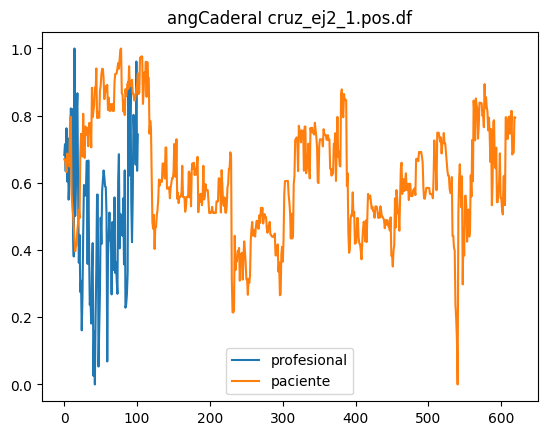

Numero de frames del profesional = 102
Numero de frames del paciente = 620


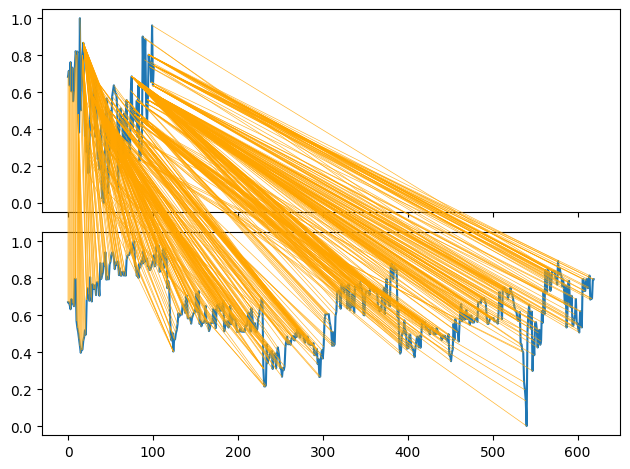

1.7957357892558037


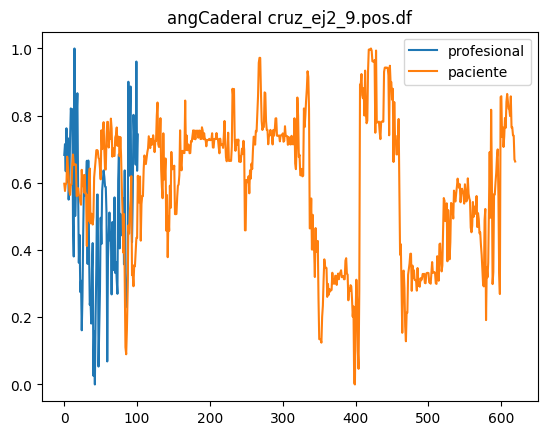

Numero de frames del profesional = 102
Numero de frames del paciente = 620


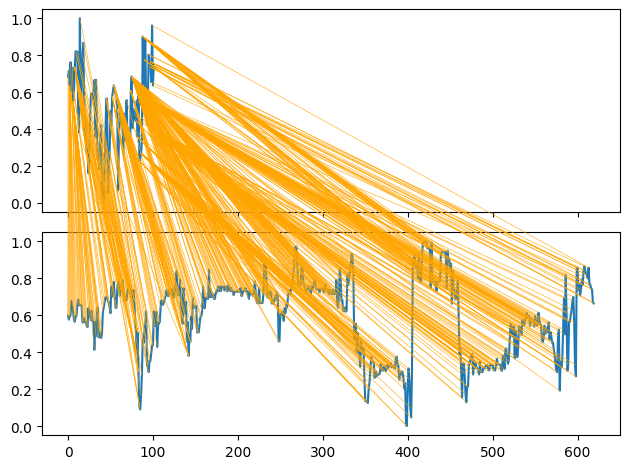

2.3802972618485447


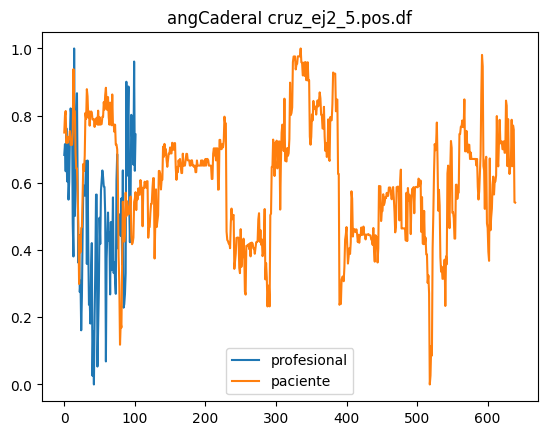

Numero de frames del profesional = 102
Numero de frames del paciente = 640


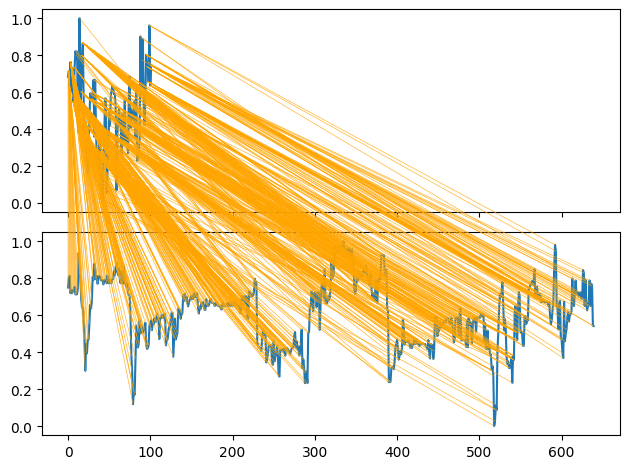

2.1654148801773805


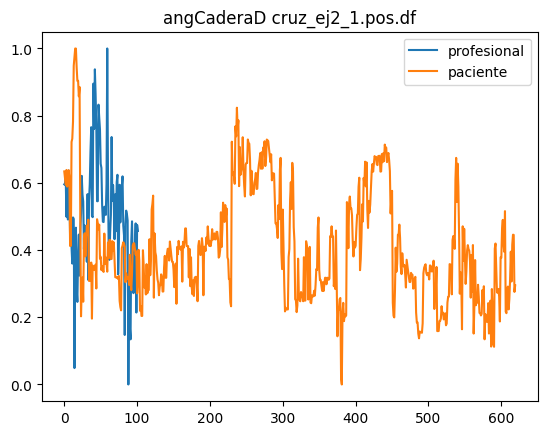

Numero de frames del profesional = 102
Numero de frames del paciente = 620


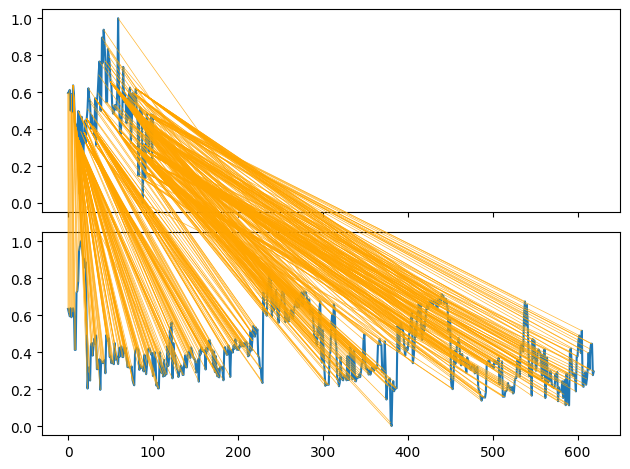

2.0841923227593893


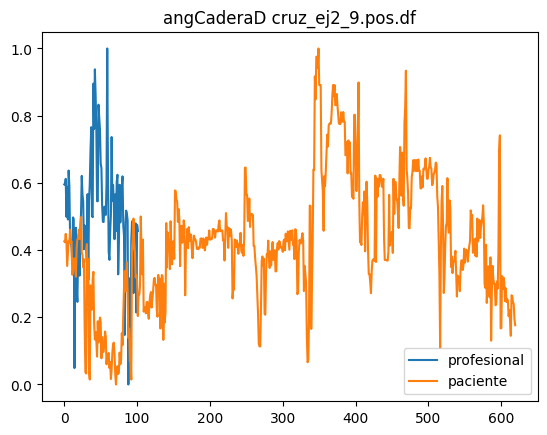

Numero de frames del profesional = 102
Numero de frames del paciente = 620


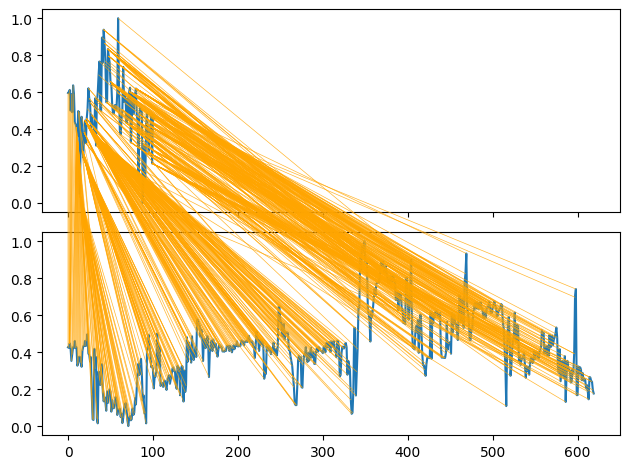

2.0521935068950103


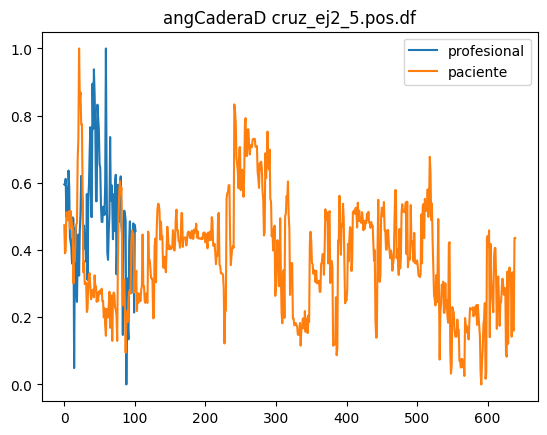

Numero de frames del profesional = 102
Numero de frames del paciente = 640


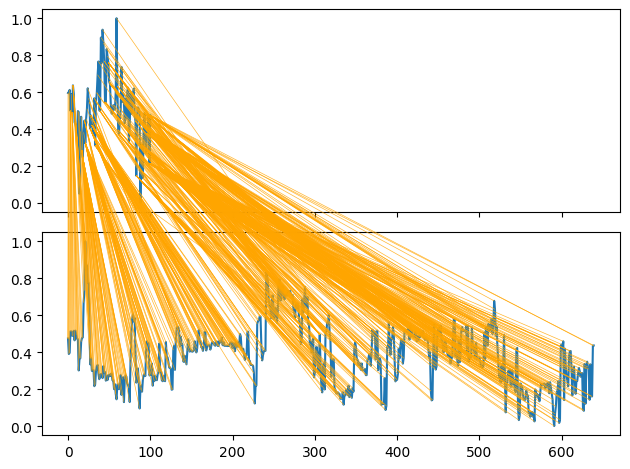

2.1097006356009134


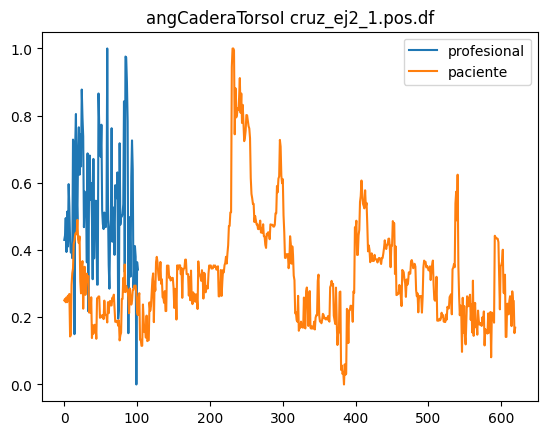

Numero de frames del profesional = 102
Numero de frames del paciente = 620


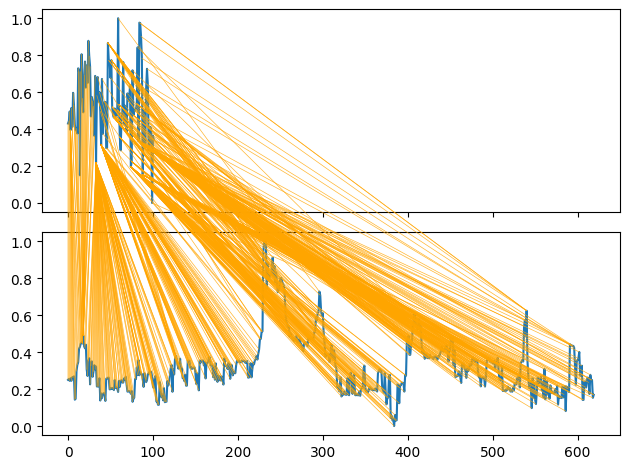

2.3102763315183714


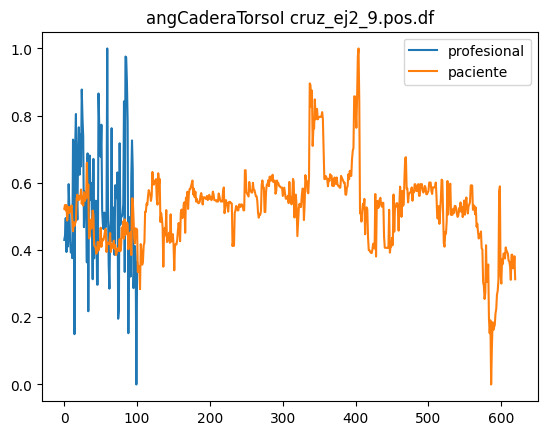

Numero de frames del profesional = 102
Numero de frames del paciente = 620


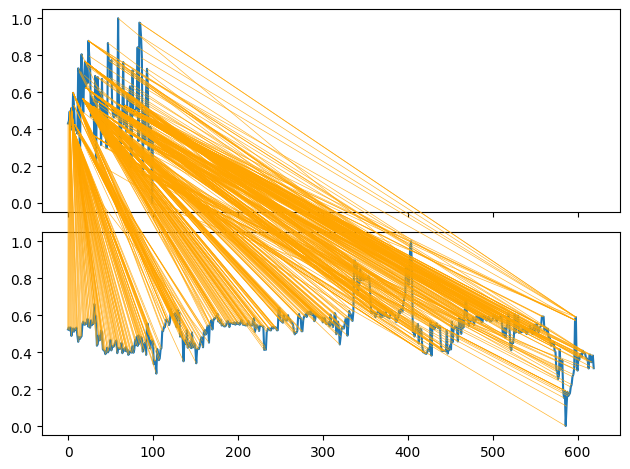

1.7734382907011945


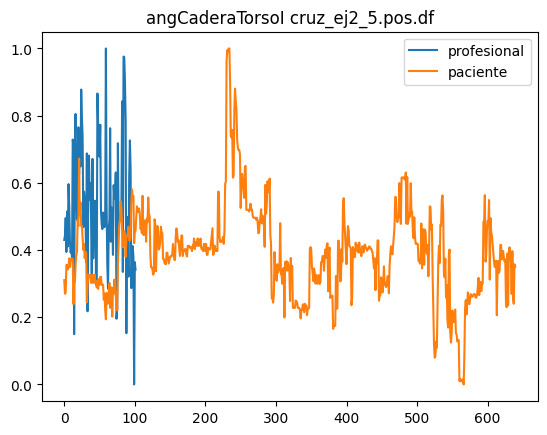

Numero de frames del profesional = 102
Numero de frames del paciente = 640


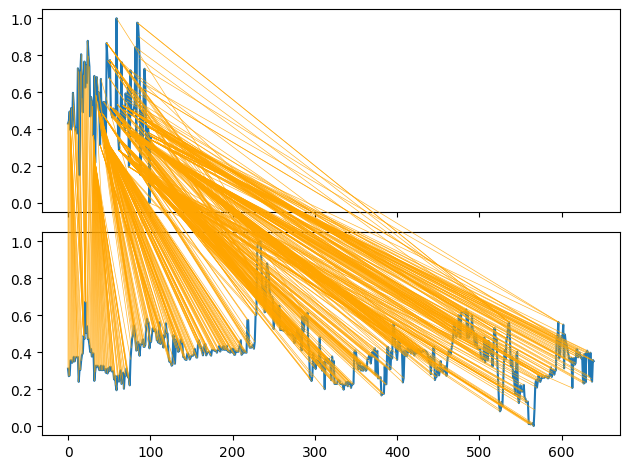

2.1656748161802684


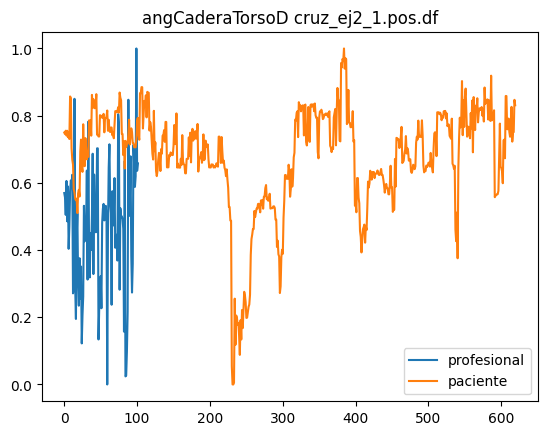

Numero de frames del profesional = 102
Numero de frames del paciente = 620


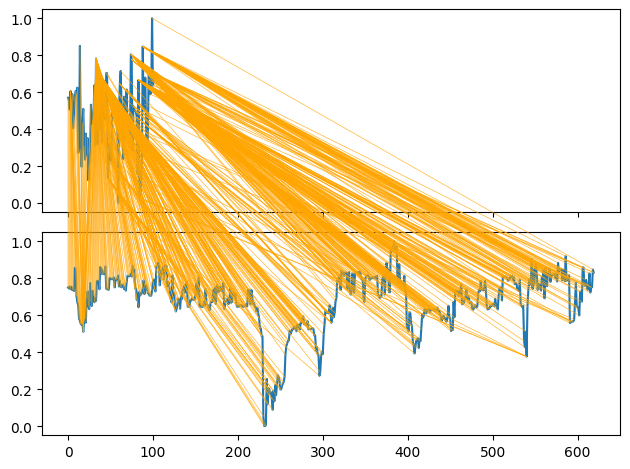

2.310265707965287


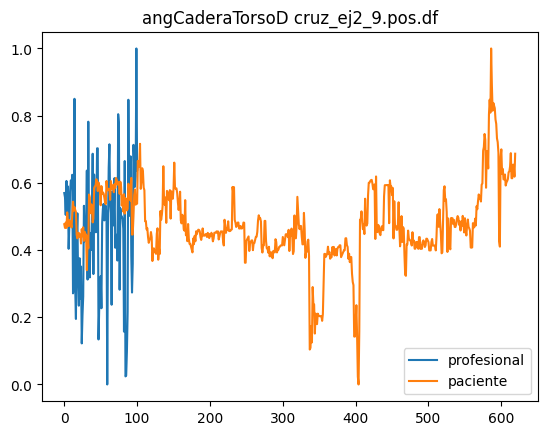

Numero de frames del profesional = 102
Numero de frames del paciente = 620


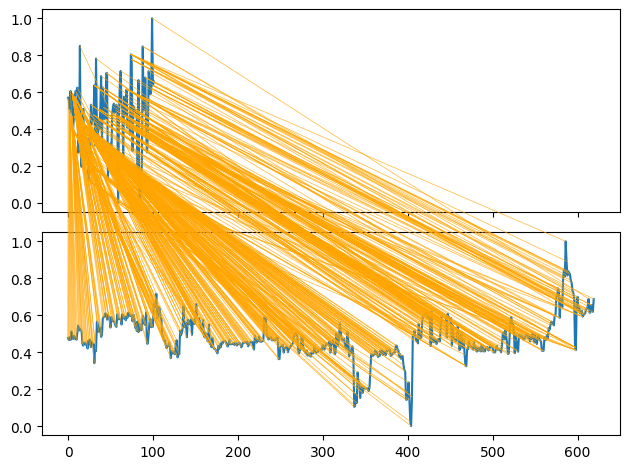

1.7734333092582342


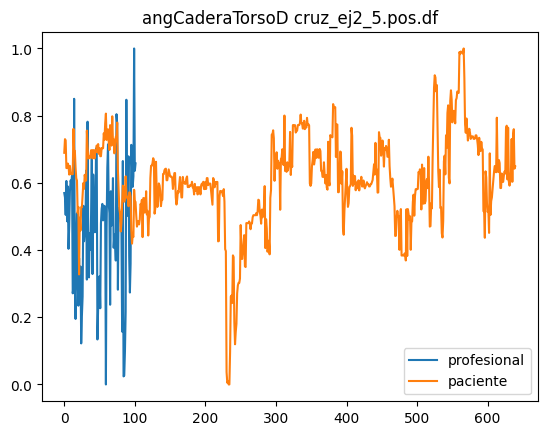

Numero de frames del profesional = 102
Numero de frames del paciente = 640


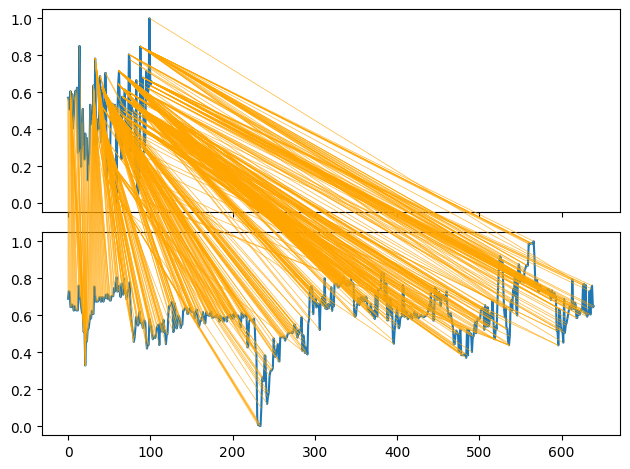

2.1656683431607173


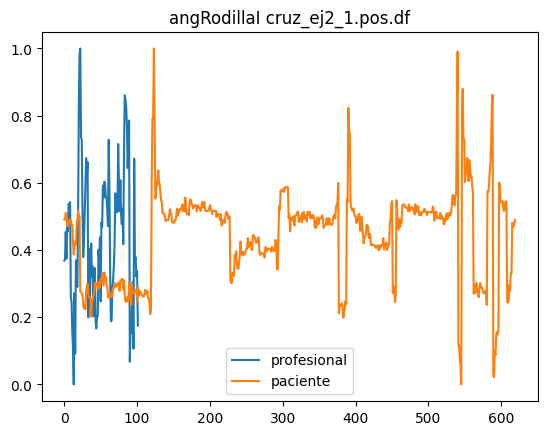

Numero de frames del profesional = 102
Numero de frames del paciente = 620


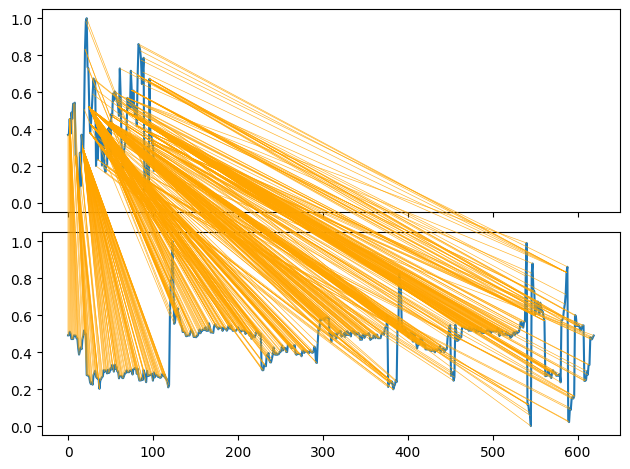

1.7020117147632563


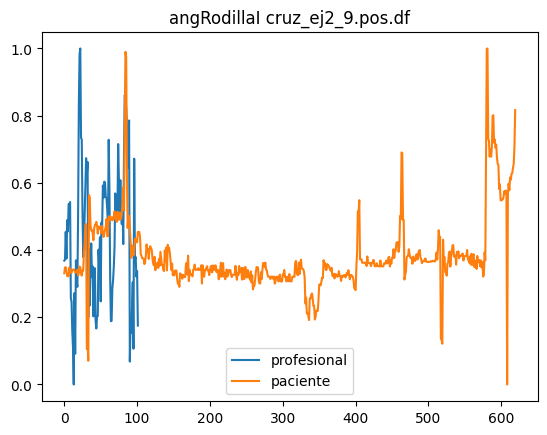

Numero de frames del profesional = 102
Numero de frames del paciente = 620


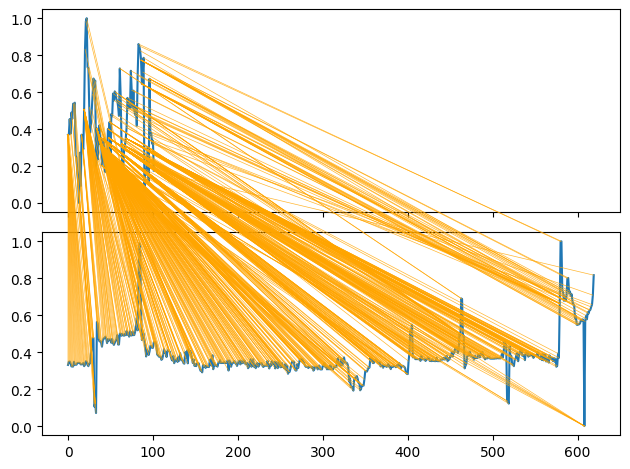

1.6209475689206296


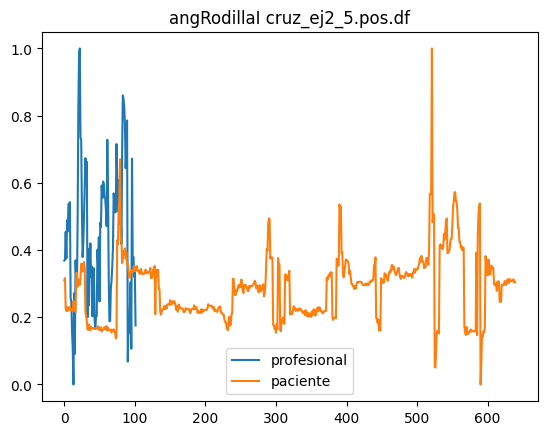

Numero de frames del profesional = 102
Numero de frames del paciente = 640


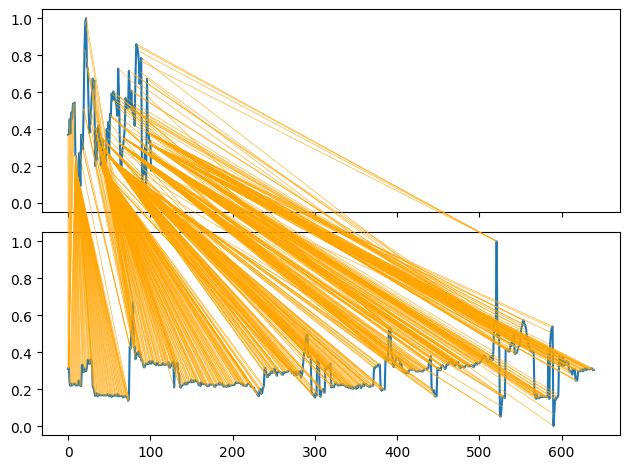

1.7745031217592606


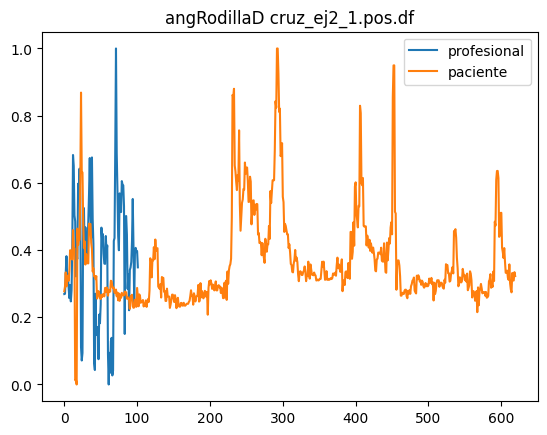

Numero de frames del profesional = 102
Numero de frames del paciente = 620


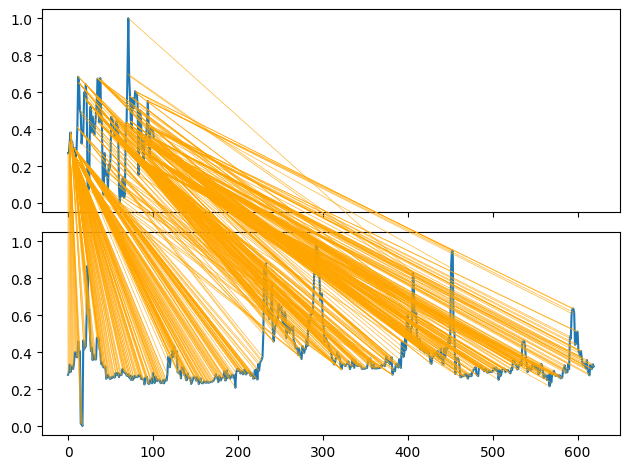

1.9189325776916235


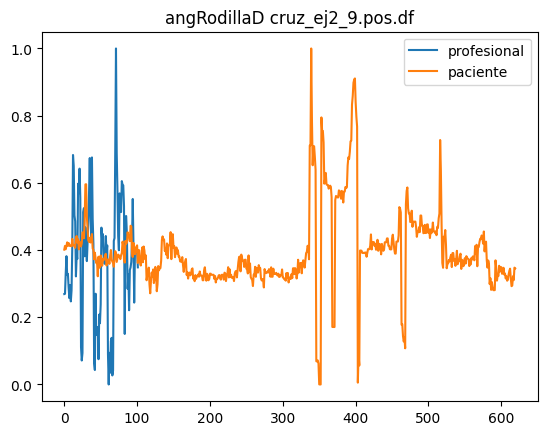

Numero de frames del profesional = 102
Numero de frames del paciente = 620


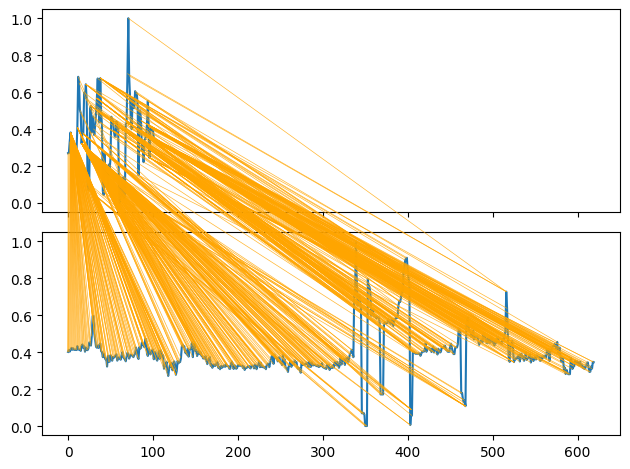

1.5605271973598969


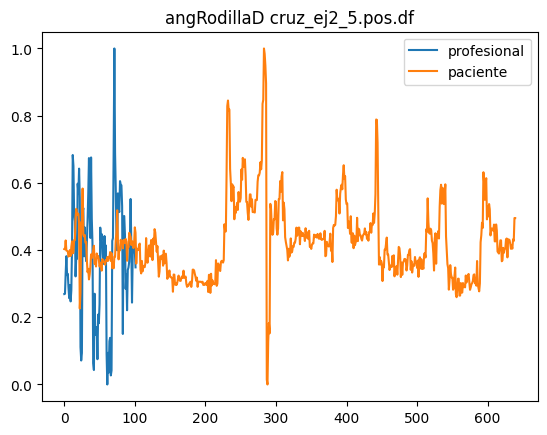

Numero de frames del profesional = 102
Numero de frames del paciente = 640


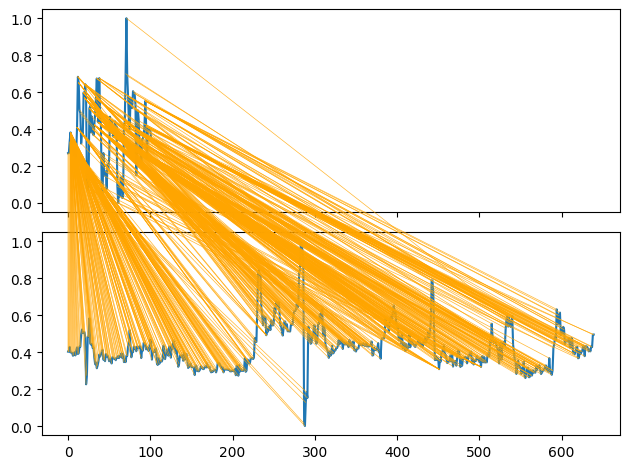

1.6995990129133347


In [20]:
for i in angles_cruz_ej2:
    profesional_ej = None
    for ej, profesional in cruz_ej2_profesionals.items():

        profesional_ej = profesional[i]
    
    for ej, patient in cruz_ej2_patients.items():
        plt.plot(profesional_ej, label="profesional")
        plt.plot(patient[i], label="paciente")
        plt.title(i + " " + ej)
        plt.legend()
        plt.show()
        print("Numero de frames del profesional =",len(profesional_ej))
        print("Numero de frames del paciente =",len(patient[i]))
        distance, paths = dtw.warping_paths_fast(np.asarray(profesional_ej), np.asarray(patient[i]))
        best_path = dtw.best_path(paths)
        dtwvis.plot_warping(profesional_ej, patient[i], best_path)
        plt.show()

        print(distance)


Cruz_ej3

In [21]:
angles_cruz_ej3 = [
    'angCaderaI', 
    'angCaderaD', 
    'angCaderaTorsoI', 
    'angCaderaTorsoD',
    'angRodillaI', 
    'angRodillaD'
    ]

In [22]:
dataframes_cruz_ej3_patients = get_filenames_patients("cruz_ej3")
dataframes_cruz_ej3_patients = dataframes_cruz_ej3_patients[:3]
cruz_ej3_patients = {}
for ej3 in dataframes_cruz_ej3_patients:
    temp = open_dataframe(ej3)
    temp = temp[angles_cruz_ej3]
    cruz_ej3_patients[ej3] = temp

dataframes_cruz_ej3_profesionals = get_filenames_profesionals("cruz_ej3")
cruz_ej3_profesionals = {}
for ej3 in dataframes_cruz_ej3_profesionals:
    temp = open_numpy(ej3)
    temp = temp[angles_cruz_ej3]
    cruz_ej3_profesionals[ej3] = temp


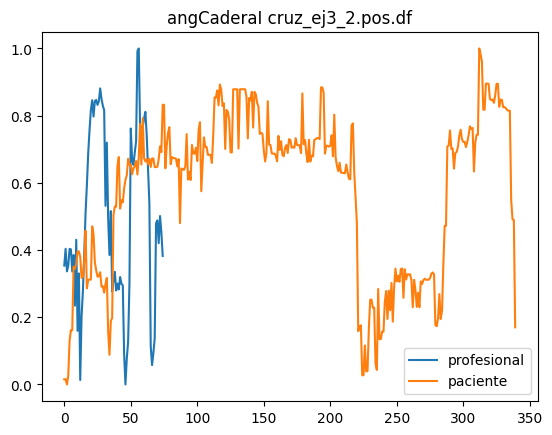

Numero de frames del profesional = 75
Numero de frames del paciente = 340


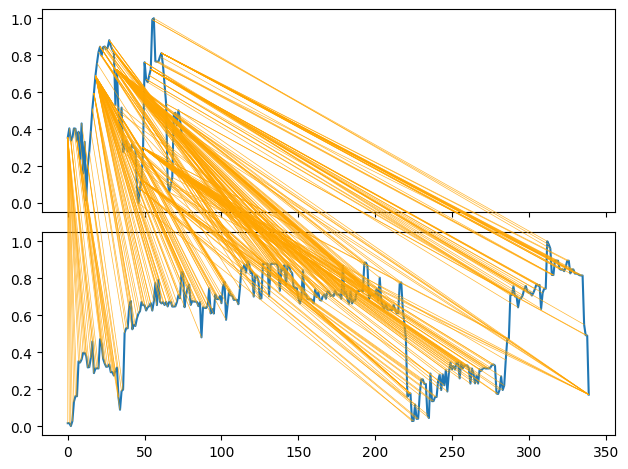

1.5361721005915547


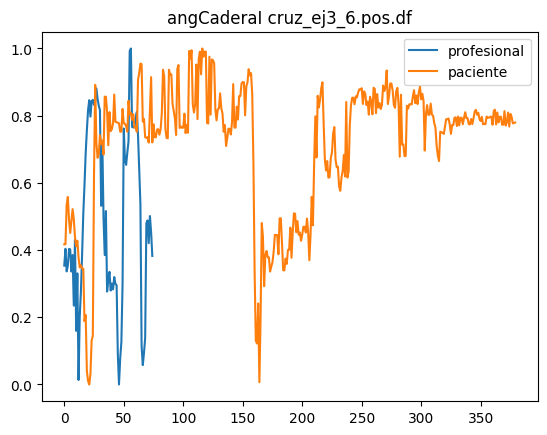

Numero de frames del profesional = 75
Numero de frames del paciente = 380


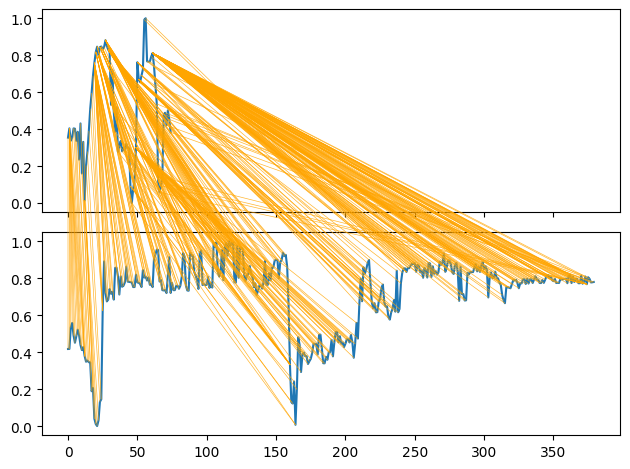

2.2110663897542633


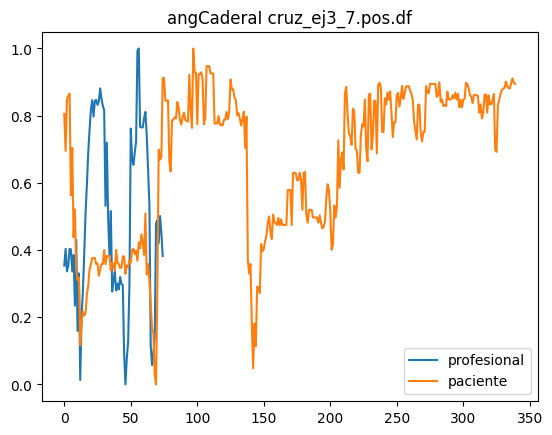

Numero de frames del profesional = 75
Numero de frames del paciente = 340


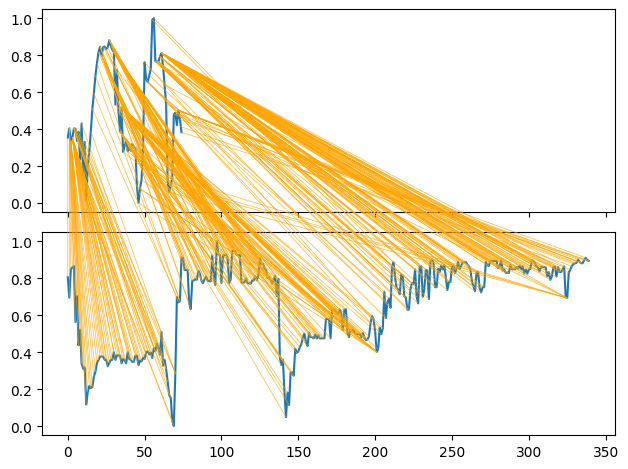

2.606177364555331


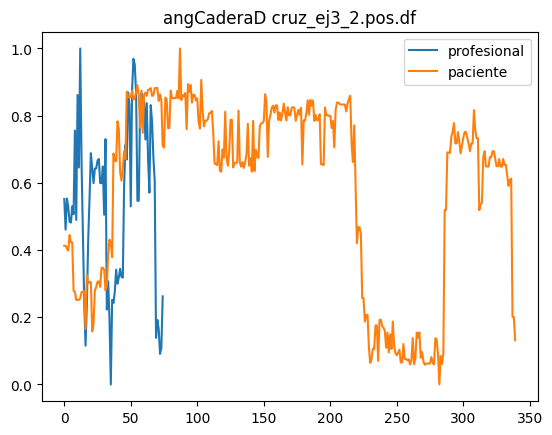

Numero de frames del profesional = 75
Numero de frames del paciente = 340


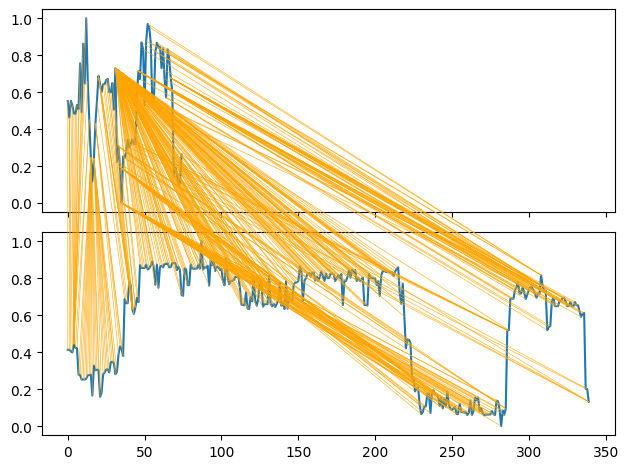

1.9260626367173188


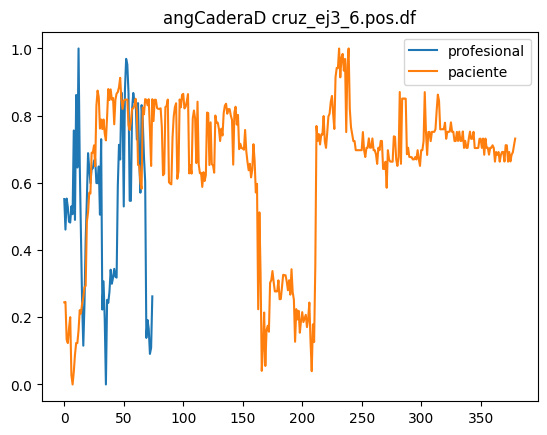

Numero de frames del profesional = 75
Numero de frames del paciente = 380


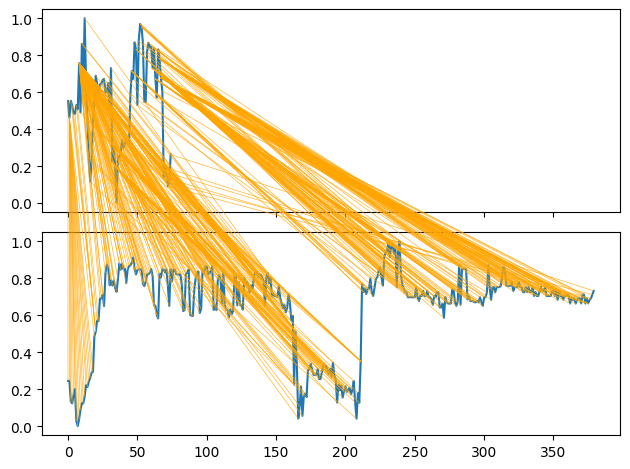

2.3530645305952773


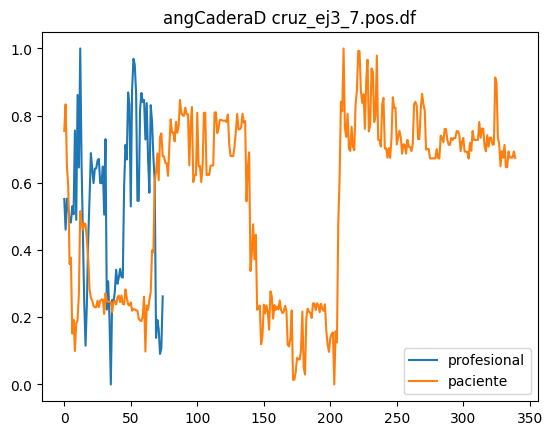

Numero de frames del profesional = 75
Numero de frames del paciente = 340


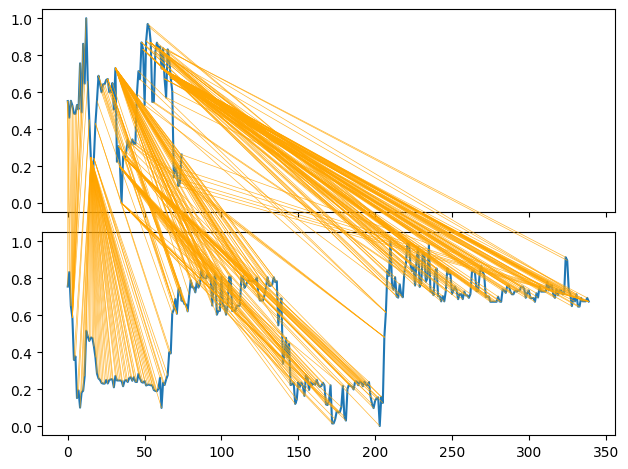

1.977708567657121


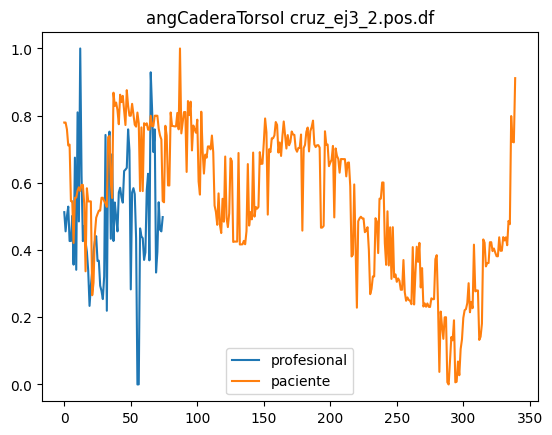

Numero de frames del profesional = 75
Numero de frames del paciente = 340


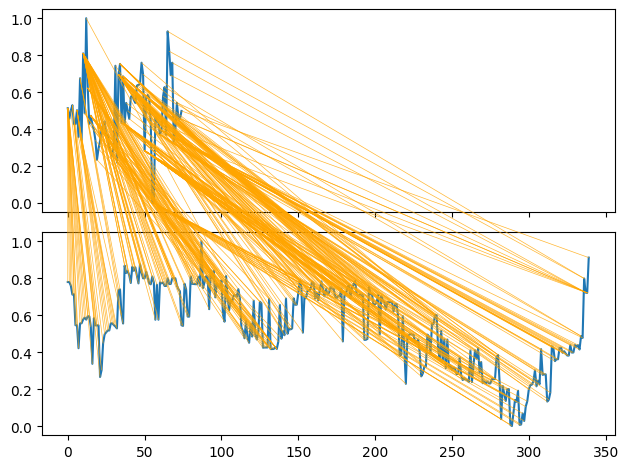

1.9895868014510008


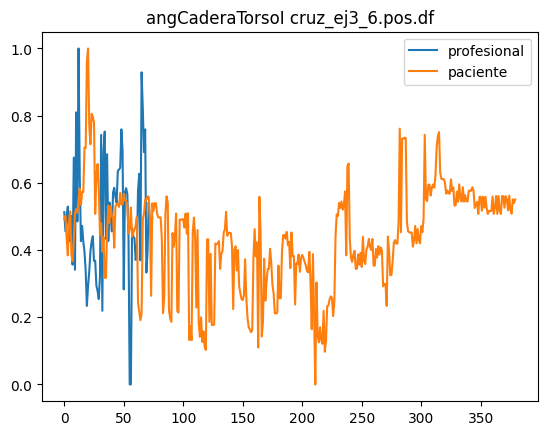

Numero de frames del profesional = 75
Numero de frames del paciente = 380


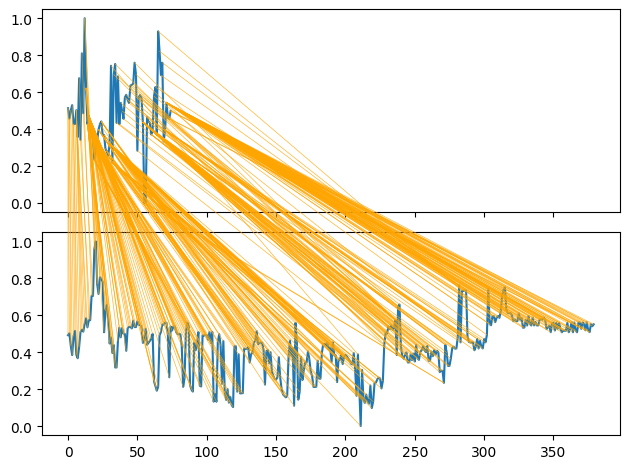

1.7841969060301957


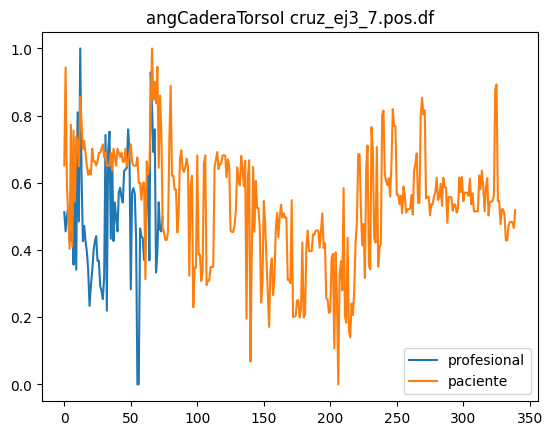

Numero de frames del profesional = 75
Numero de frames del paciente = 340


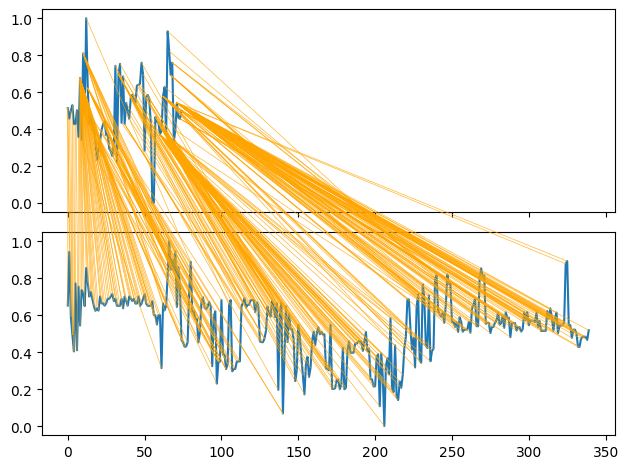

1.8995885547633173


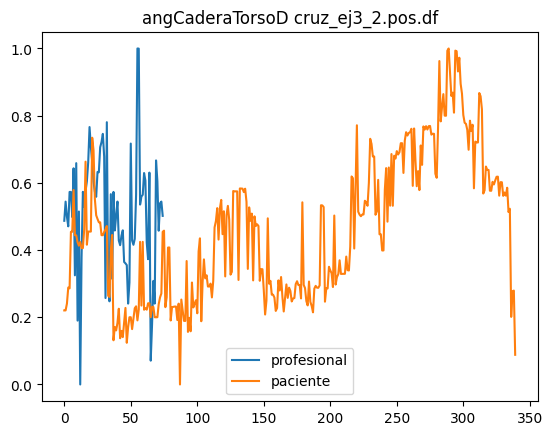

Numero de frames del profesional = 75
Numero de frames del paciente = 340


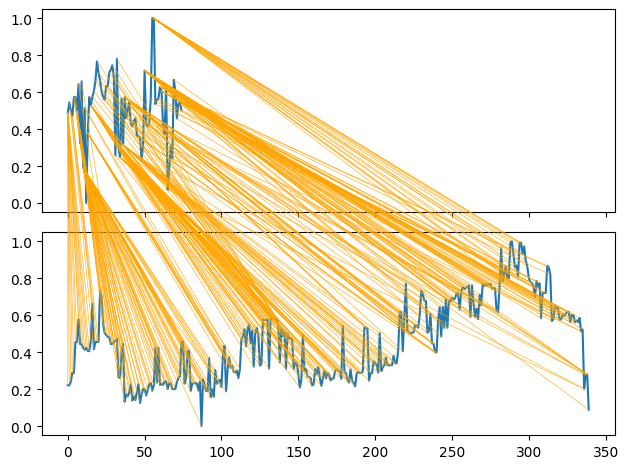

1.9895789967305564


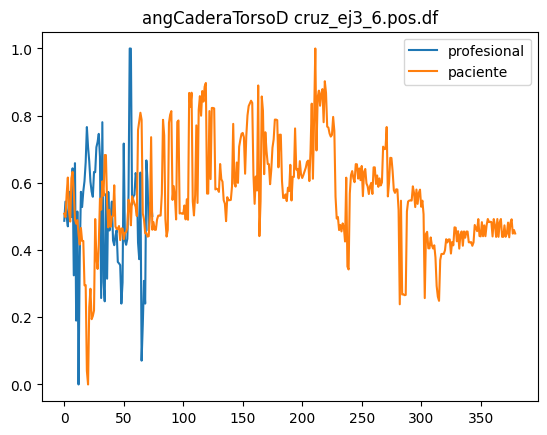

Numero de frames del profesional = 75
Numero de frames del paciente = 380


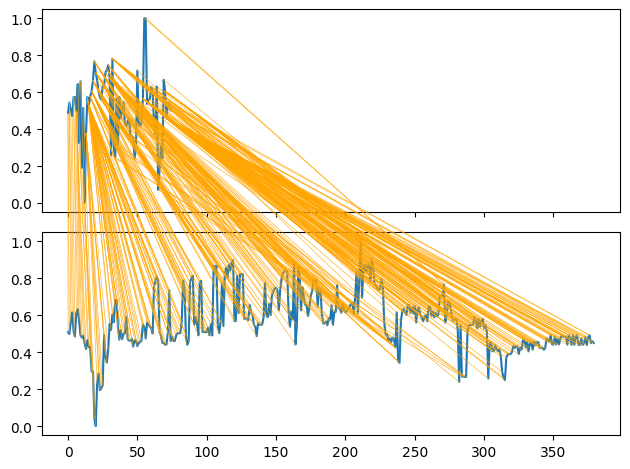

1.784191572653878


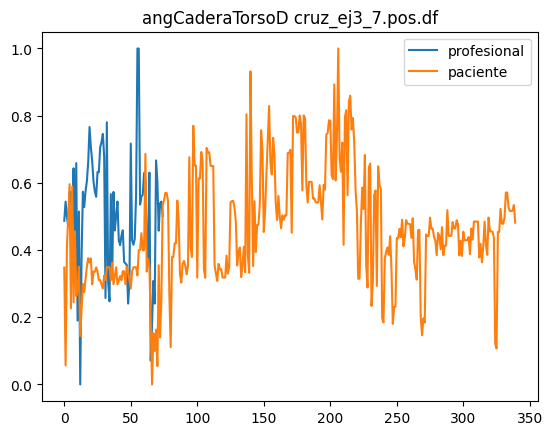

Numero de frames del profesional = 75
Numero de frames del paciente = 340


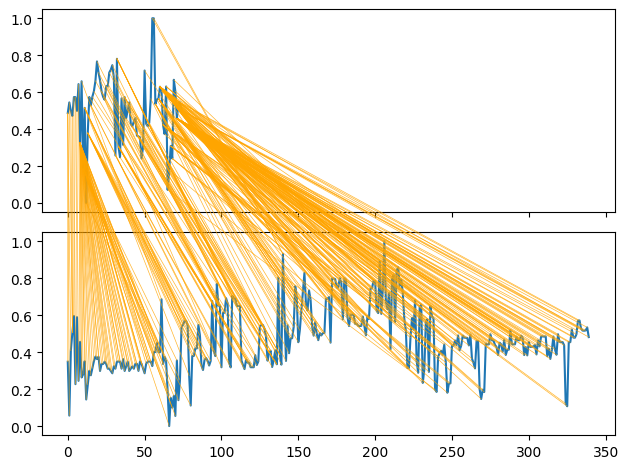

1.8995908682268388


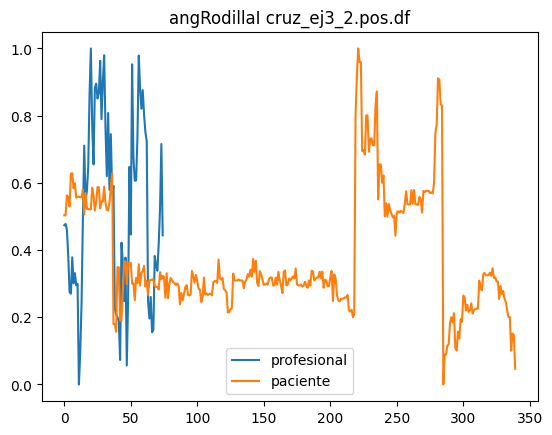

Numero de frames del profesional = 75
Numero de frames del paciente = 340


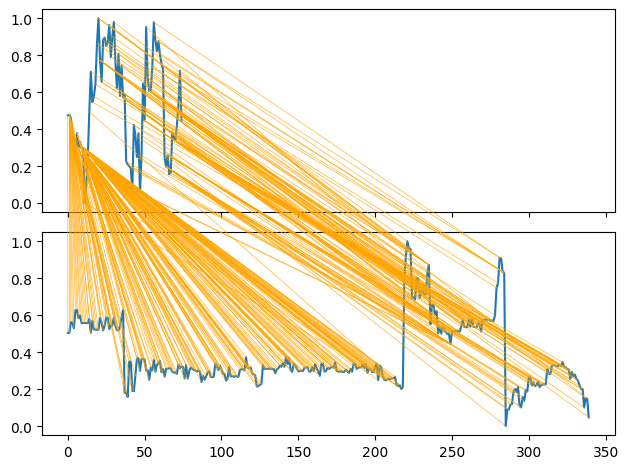

1.6746423157995696


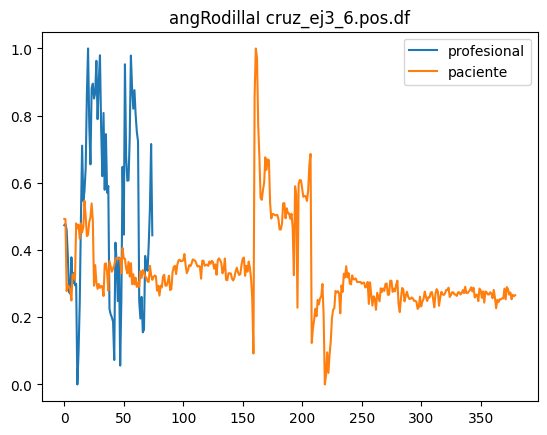

Numero de frames del profesional = 75
Numero de frames del paciente = 380


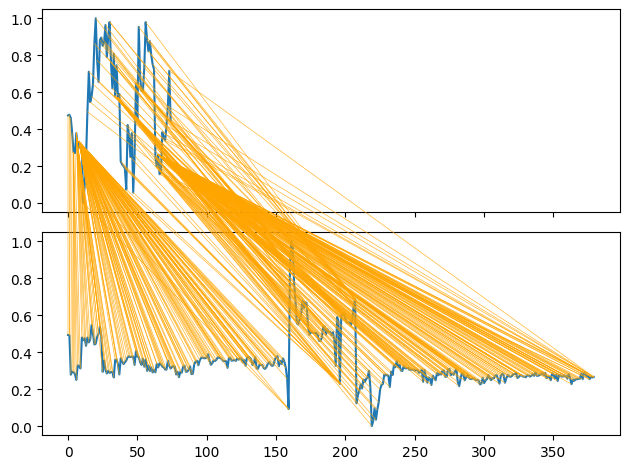

1.46258033494952


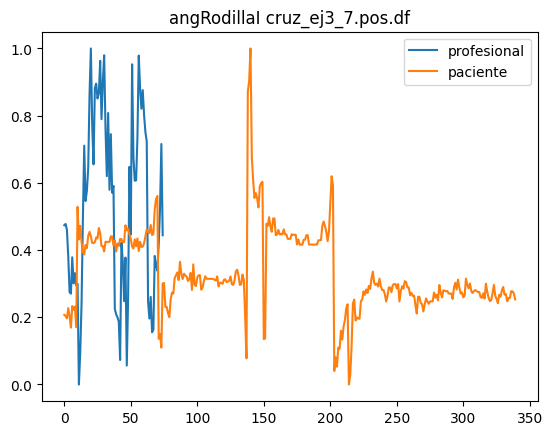

Numero de frames del profesional = 75
Numero de frames del paciente = 340


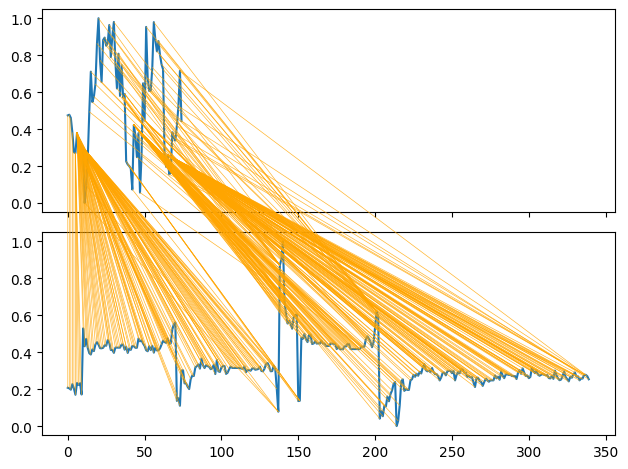

1.6390796176318847


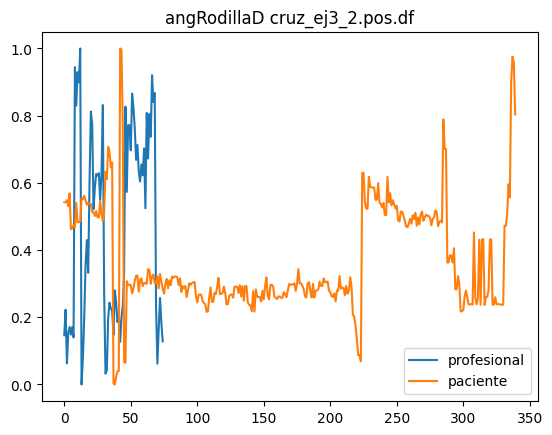

Numero de frames del profesional = 75
Numero de frames del paciente = 340


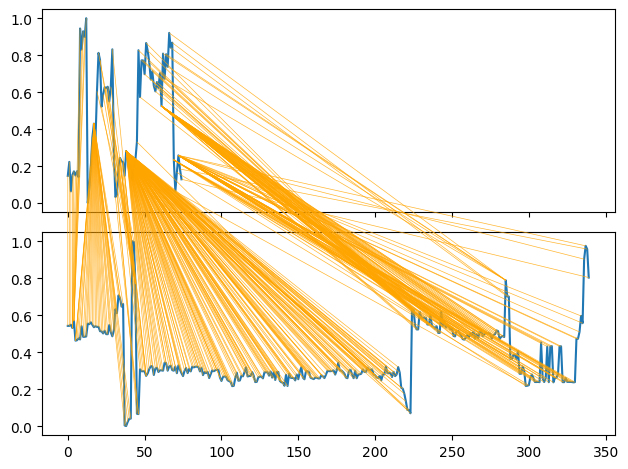

2.664674752269942


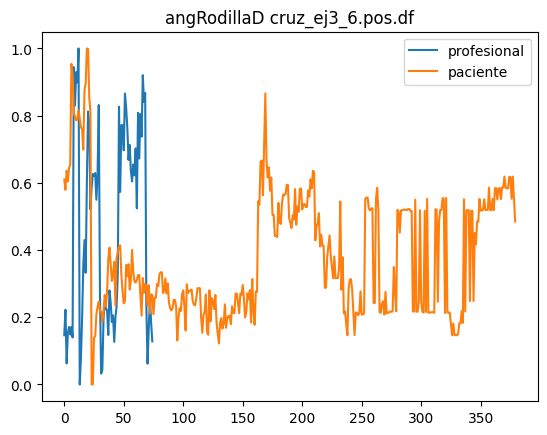

Numero de frames del profesional = 75
Numero de frames del paciente = 380


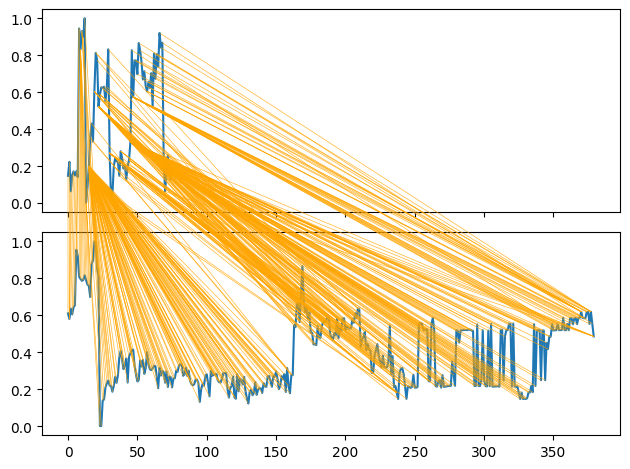

2.6631021022280077


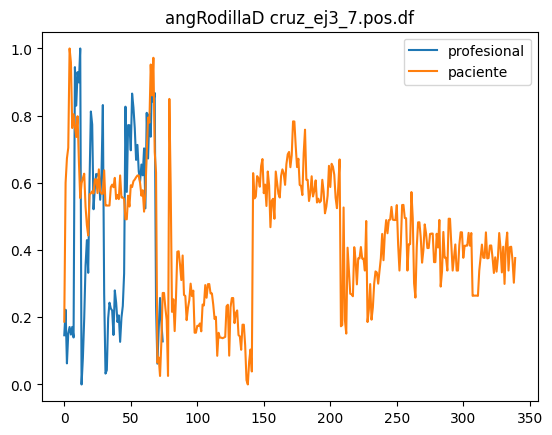

Numero de frames del profesional = 75
Numero de frames del paciente = 340


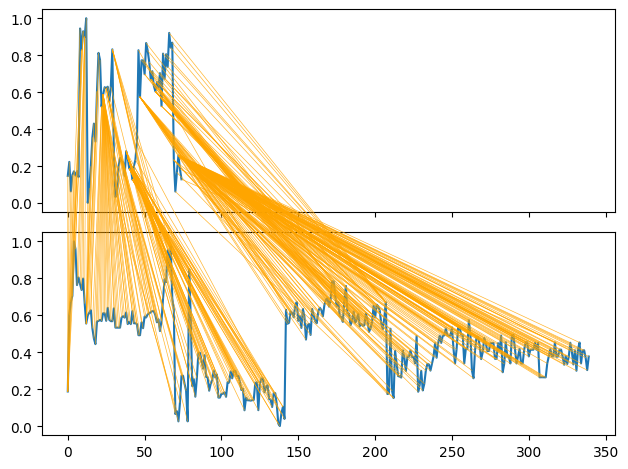

2.3904356667748563


In [23]:
for i in angles_cruz_ej3:
    profesional_ej = None
    for ej, profesional in cruz_ej3_profesionals.items():

        profesional_ej = profesional[i]
    
    for ej, patient in cruz_ej3_patients.items():
        plt.plot(profesional_ej, label="profesional")
        plt.plot(patient[i], label="paciente")
        plt.title(i + " " + ej)
        plt.legend()
        plt.show()
        print("Numero de frames del profesional =",len(profesional_ej))
        print("Numero de frames del paciente =",len(patient[i]))
        distance, paths = dtw.warping_paths_fast(np.asarray(profesional_ej), np.asarray(patient[i]))
        best_path = dtw.best_path(paths)
        dtwvis.plot_warping(profesional_ej, patient[i], best_path)
        plt.show()

        print(distance)

Cruz_ej4

In [24]:
angles_cruz_ej4 = [
    'angCaderaI', 
    'angCaderaD', 
    'angCaderaTorsoI', 
    'angCaderaTorsoD',
    'angRodillaI', 
    'angRodillaD'
    ]

In [25]:
dataframes_cruz_ej4_patients = get_filenames_patients("cruz_ej4")
dataframes_cruz_ej4_patients = dataframes_cruz_ej4_patients[:3]
cruz_ej4_patients = {}
for ej4 in dataframes_cruz_ej4_patients:
    temp = open_dataframe(ej4)
    temp = temp[angles_cruz_ej4]
    cruz_ej4_patients[ej4] = temp

dataframes_cruz_ej4_profesionals = get_filenames_profesionals("cruz_ej4")
cruz_ej4_profesionals = {}
for ej4 in dataframes_cruz_ej4_profesionals:
    temp = open_numpy(ej4)
    temp = temp[angles_cruz_ej4]
    cruz_ej4_profesionals[ej4] = temp

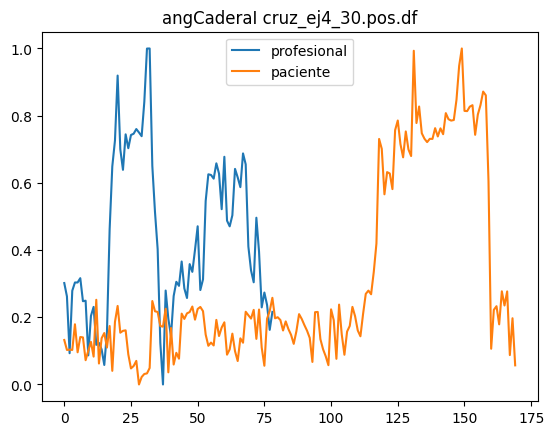

Numero de frames del profesional = 79
Numero de frames del paciente = 170


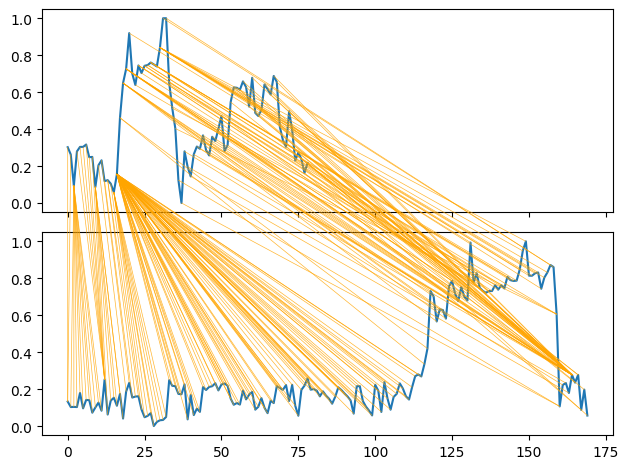

1.5883335135367593


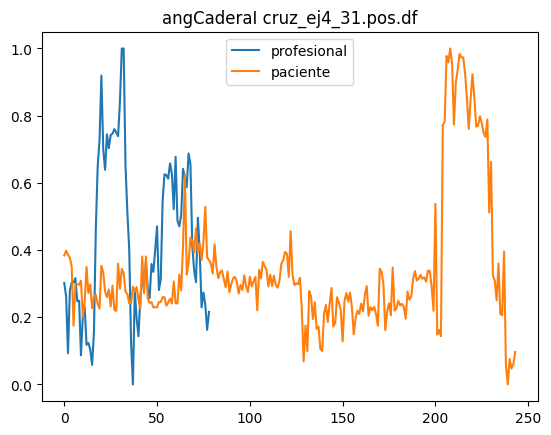

Numero de frames del profesional = 79
Numero de frames del paciente = 244


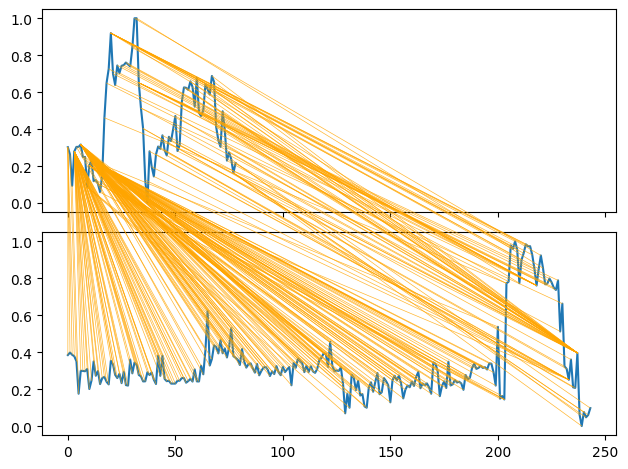

1.4764212162464725


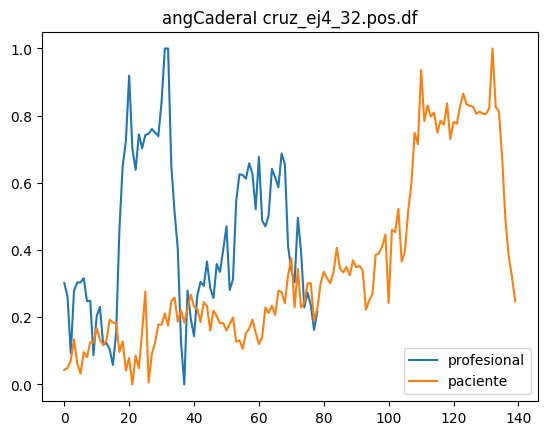

Numero de frames del profesional = 79
Numero de frames del paciente = 140


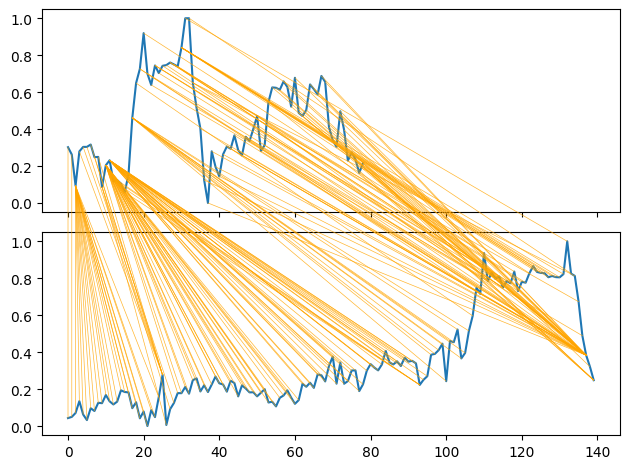

1.4157599716660845


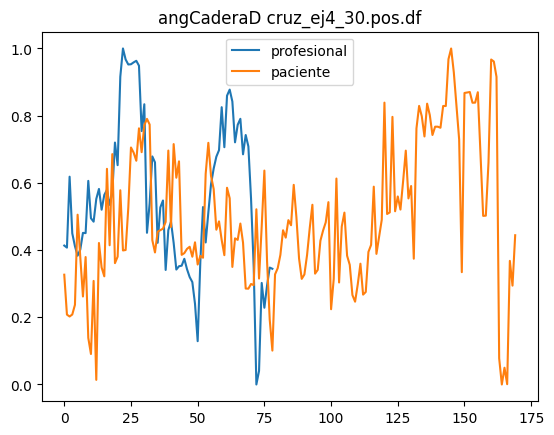

Numero de frames del profesional = 79
Numero de frames del paciente = 170


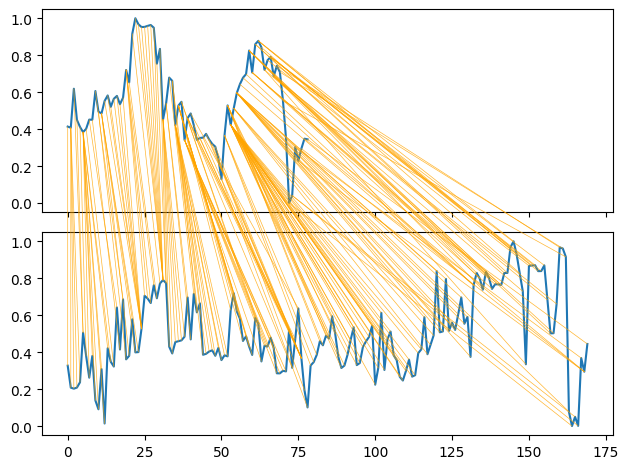

1.521417331357445


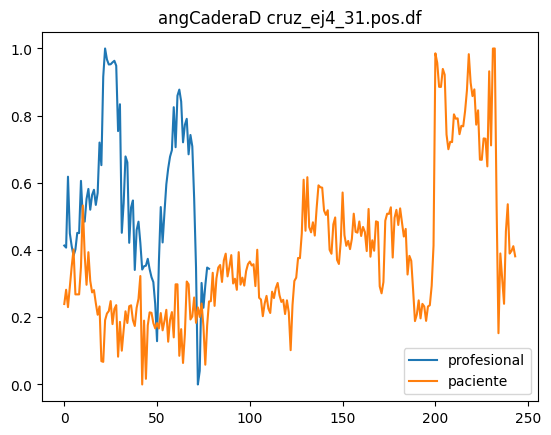

Numero de frames del profesional = 79
Numero de frames del paciente = 244


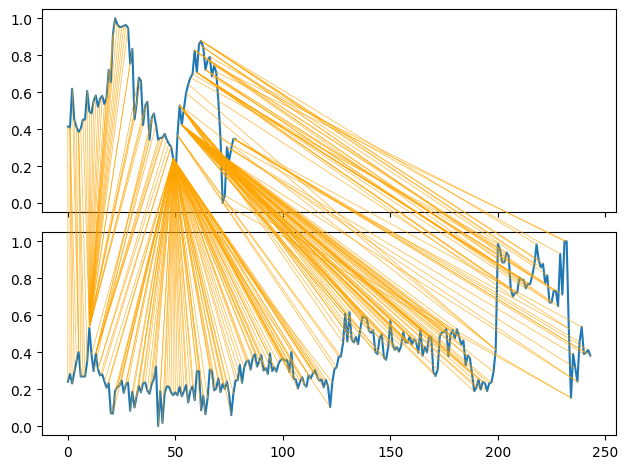

2.0054882902299025


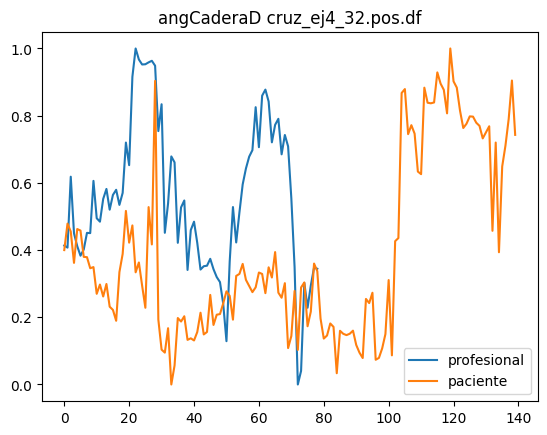

Numero de frames del profesional = 79
Numero de frames del paciente = 140


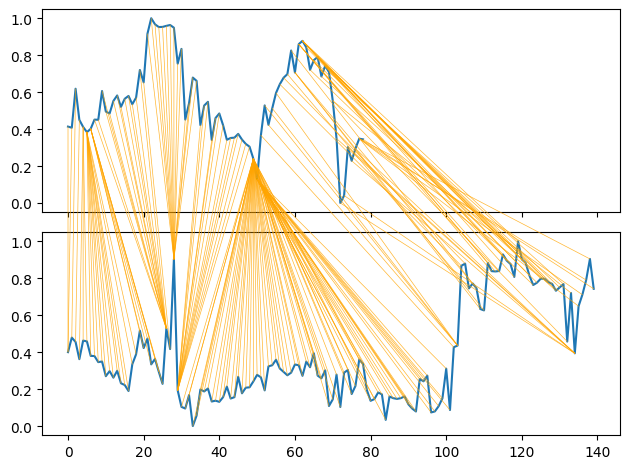

1.86416255735012


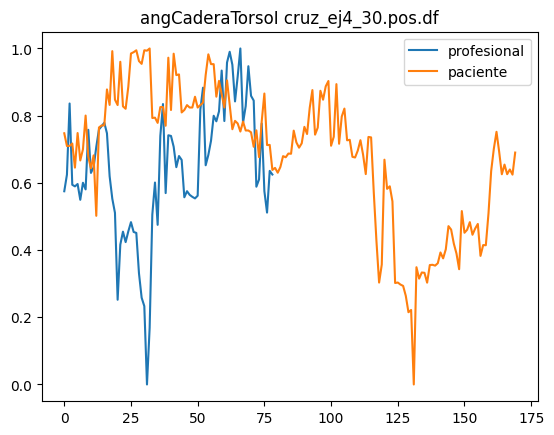

Numero de frames del profesional = 79
Numero de frames del paciente = 170


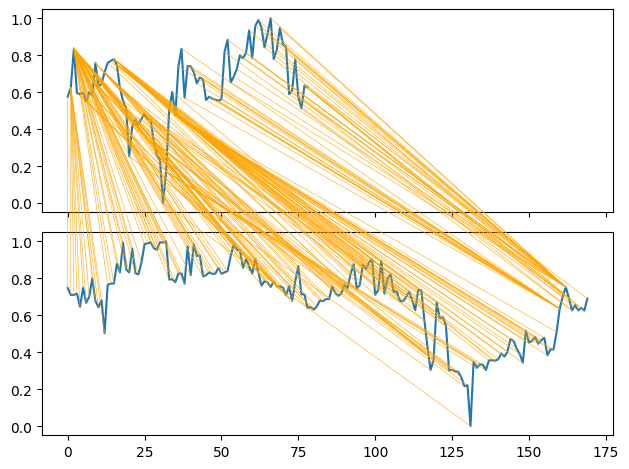

1.3135467214857082


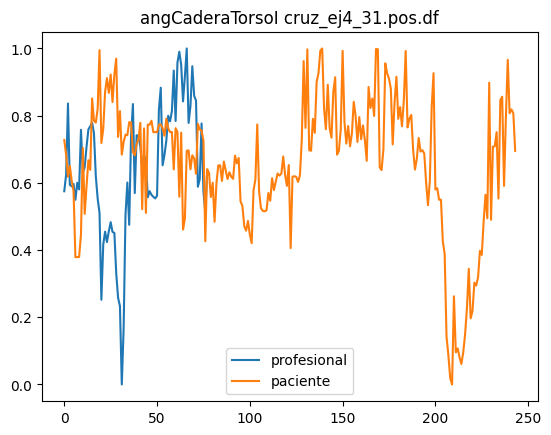

Numero de frames del profesional = 79
Numero de frames del paciente = 244


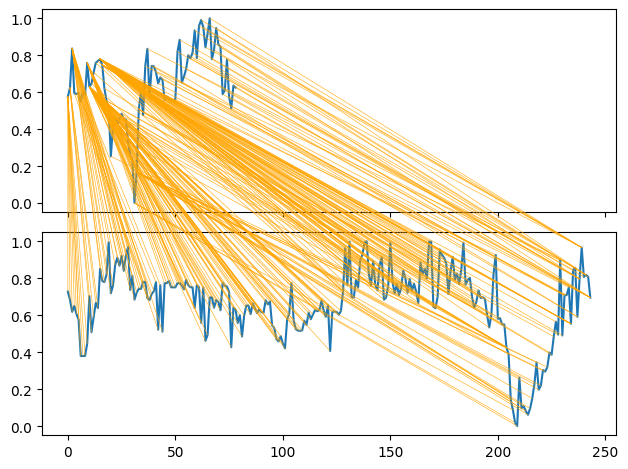

1.524815493638728


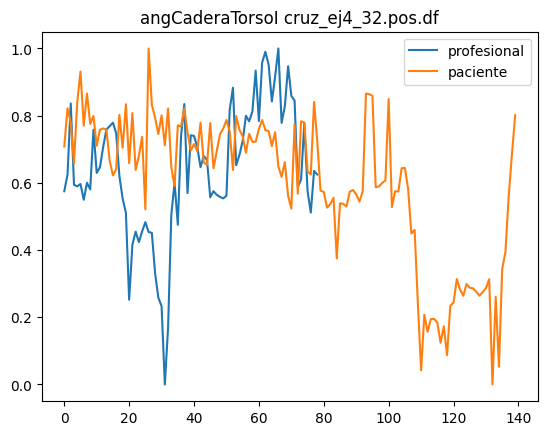

Numero de frames del profesional = 79
Numero de frames del paciente = 140


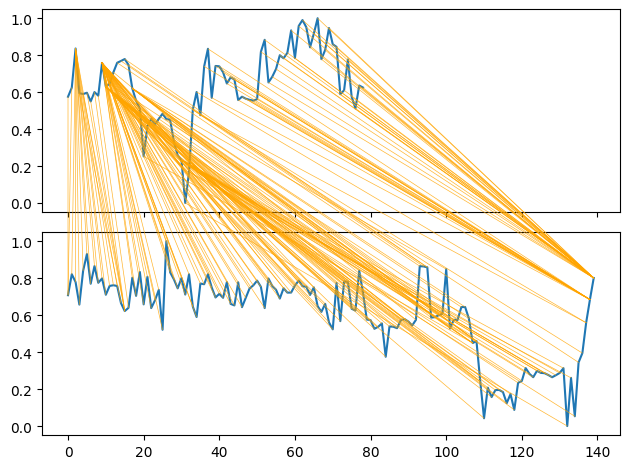

1.312474816517611


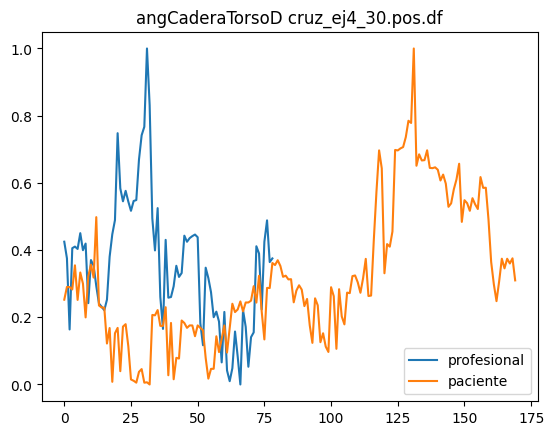

Numero de frames del profesional = 79
Numero de frames del paciente = 170


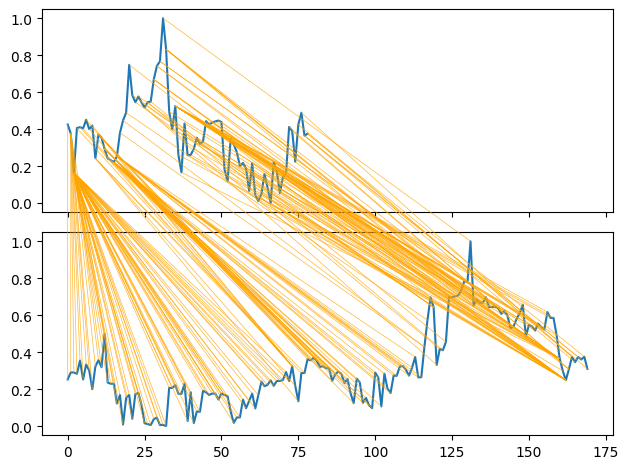

1.3135406212391951


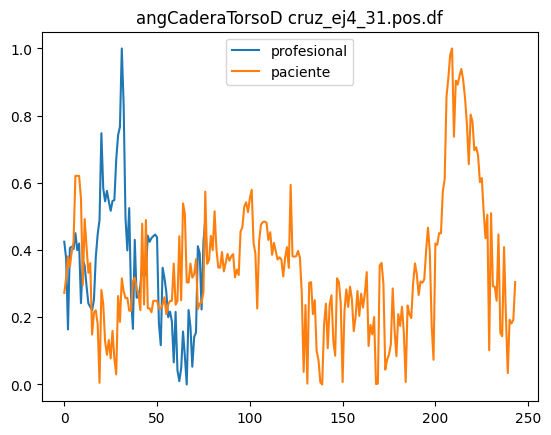

Numero de frames del profesional = 79
Numero de frames del paciente = 244


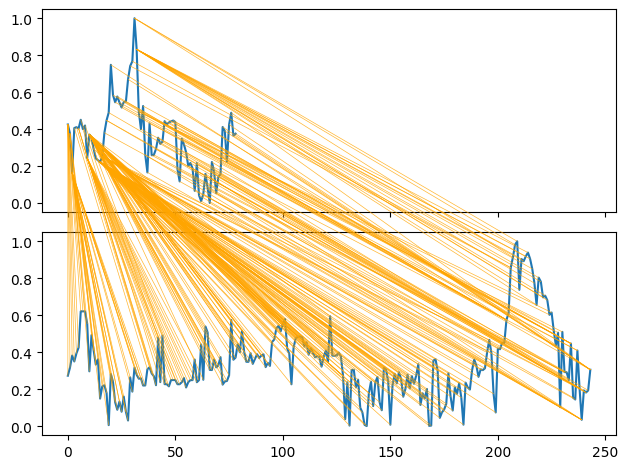

1.5248092897339152


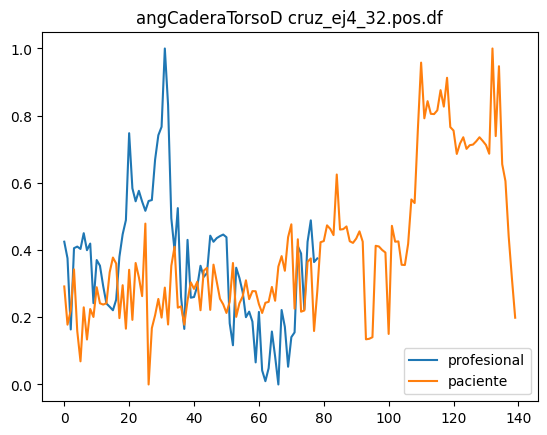

Numero de frames del profesional = 79
Numero de frames del paciente = 140


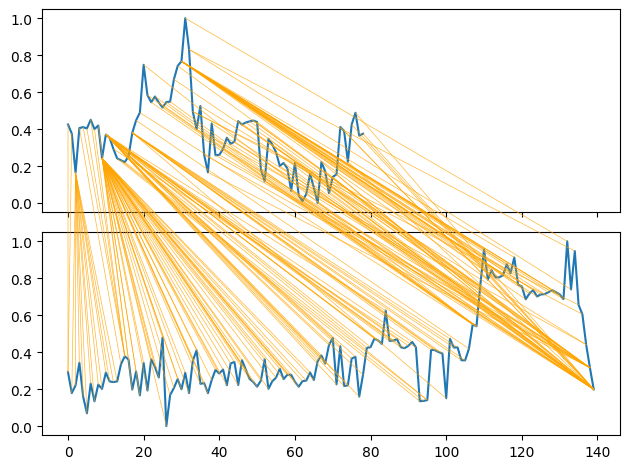

1.31247304157622


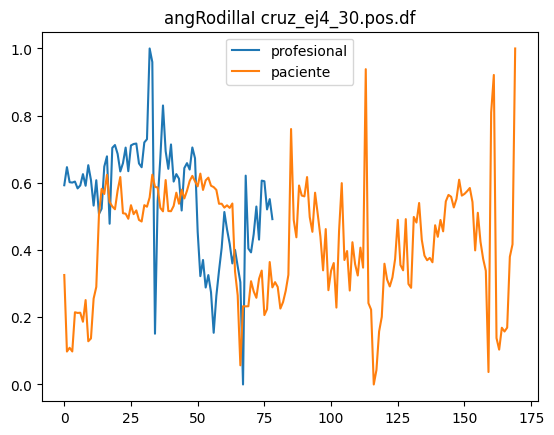

Numero de frames del profesional = 79
Numero de frames del paciente = 170


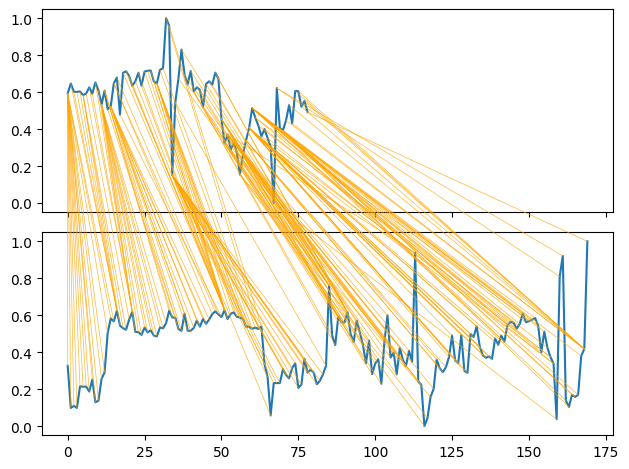

2.1661698531165348


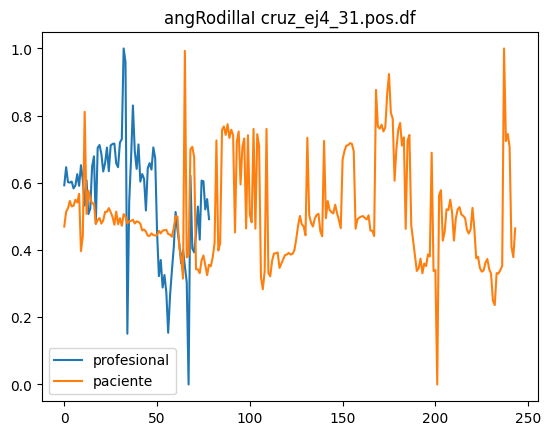

Numero de frames del profesional = 79
Numero de frames del paciente = 244


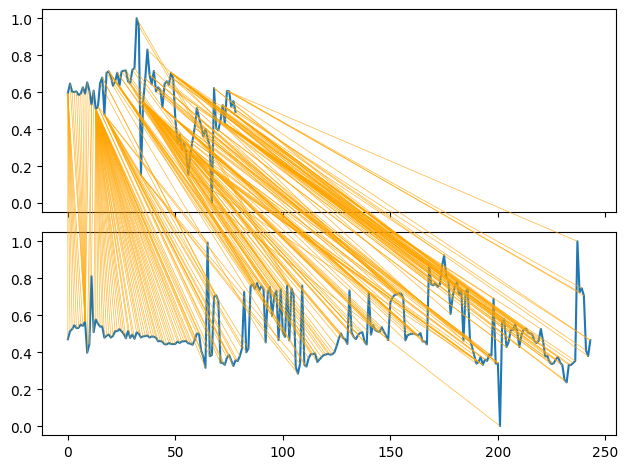

1.635984809323575


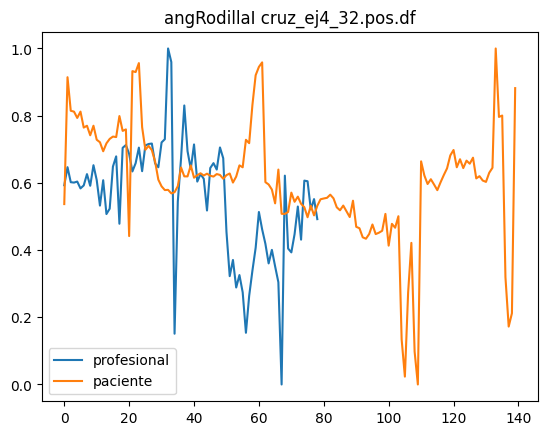

Numero de frames del profesional = 79
Numero de frames del paciente = 140


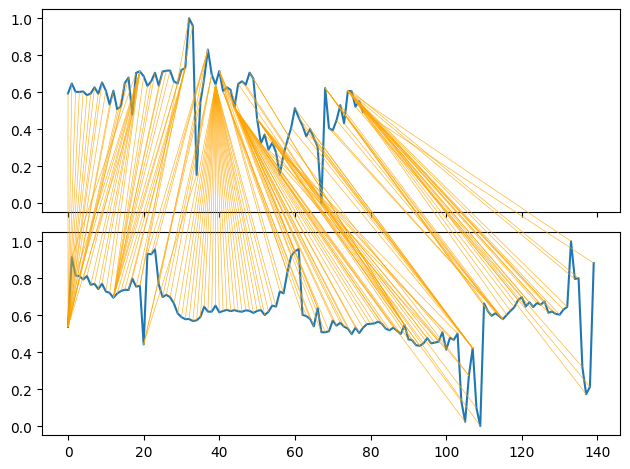

1.325123253360442


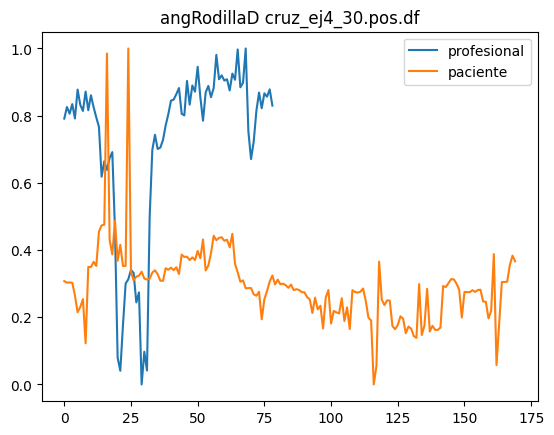

Numero de frames del profesional = 79
Numero de frames del paciente = 170


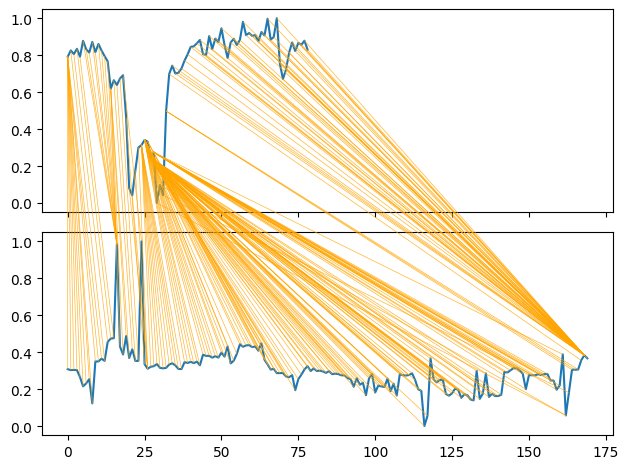

3.927980290683064


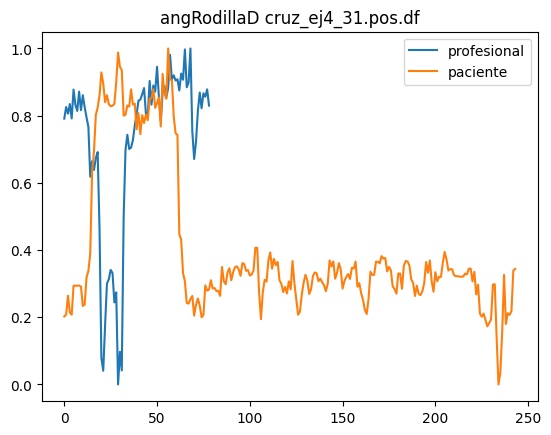

Numero de frames del profesional = 79
Numero de frames del paciente = 244


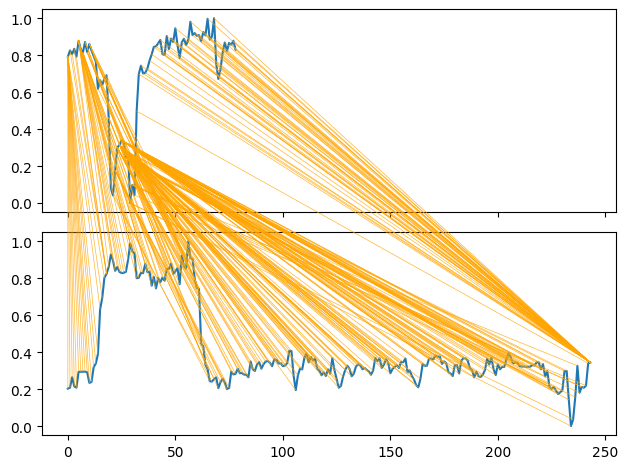

4.086913792583762


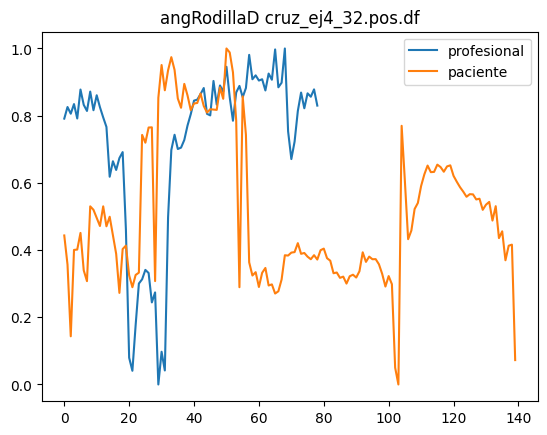

Numero de frames del profesional = 79
Numero de frames del paciente = 140


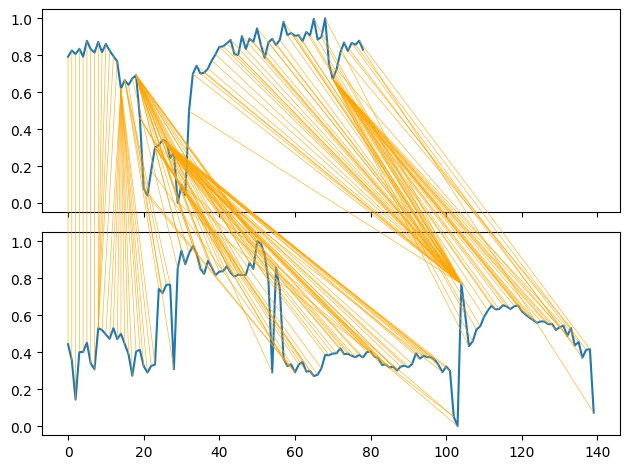

2.6649741573962764


In [26]:
for i in angles_cruz_ej4:
    profesional_ej = None
    for ej, profesional in cruz_ej4_profesionals.items():

        profesional_ej = profesional[i]
    
    for ej, patient in cruz_ej4_patients.items():
        plt.plot(profesional_ej, label="profesional")
        plt.plot(patient[i], label="paciente")
        plt.title(i + " " + ej)
        plt.legend()
        plt.show()
        print("Numero de frames del profesional =",len(profesional_ej))
        print("Numero de frames del paciente =",len(patient[i]))
        distance, paths = dtw.warping_paths_fast(np.asarray(profesional_ej), np.asarray(patient[i]))
        best_path = dtw.best_path(paths)
        dtwvis.plot_warping(profesional_ej, patient[i], best_path)
        plt.show()

        print(distance)

Pelota 1

In [27]:
angles_pelota1 = [
    'angCodoI', 
    'angCodoD', 
    'angHombroI', 
    'angHombroD'
    ]

In [28]:
dataframes_pelota1_patients = get_filenames_patients("pelota1")
dataframes_pelota1_patients = dataframes_pelota1_patients[:3]
pelota1_patients = {}
for ej1 in dataframes_pelota1_patients:
    temp = open_dataframe(ej1)
    temp = temp[angles_pelota1]
    pelota1_patients[ej1] = temp

dataframes_pelota1_profesionals = get_filenames_profesionals("pelota1")
pelota1_profesionals = {}
for ej1 in dataframes_pelota1_profesionals:
    temp = open_numpy(ej1)
    temp = temp[angles_pelota1]
    pelota1_profesionals[ej1] = temp

angCodoI


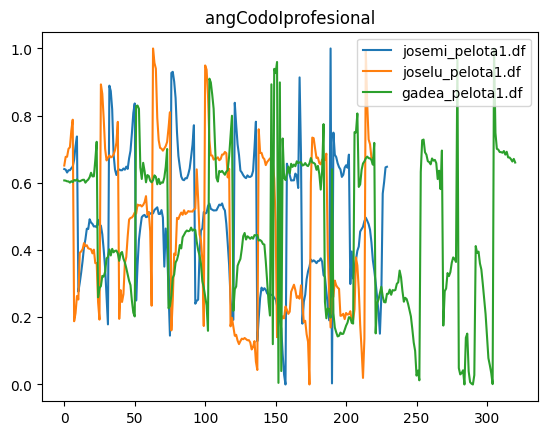

angCodoD


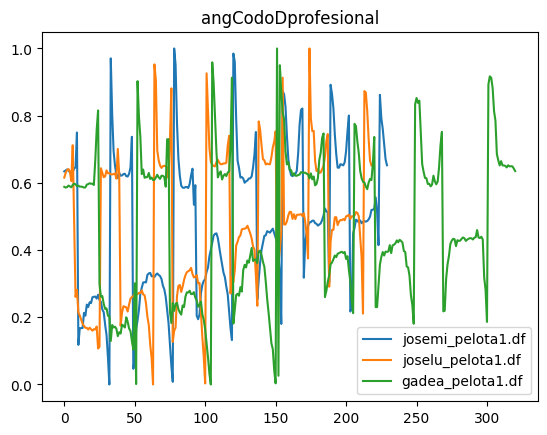

angHombroI


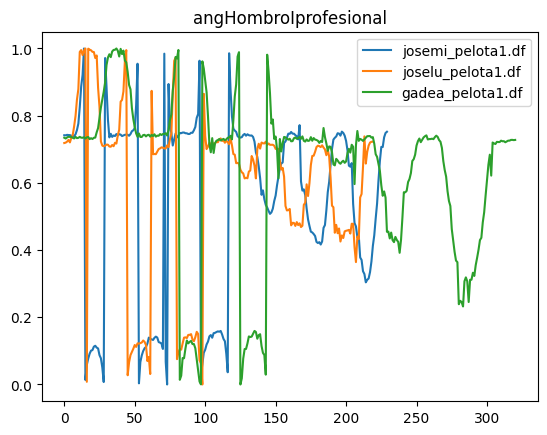

angHombroD


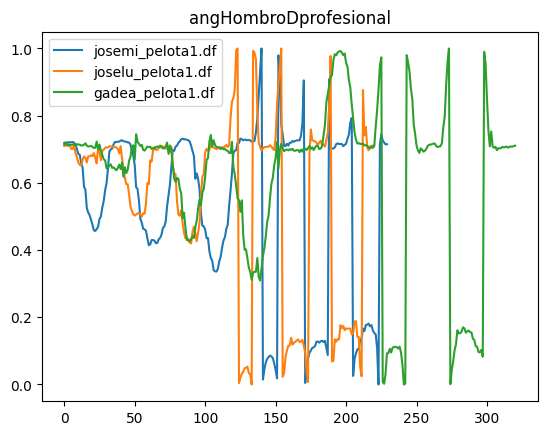

In [29]:
for i in angles_pelota1:
    #print(cruz_ej2_profesionals.items())
    print(i)
    profesional_ej = None
    for ej, profesional in pelota1_profesionals.items():
        profesional_ej = profesional[i]
    
        plt.plot(profesional_ej, label=ej)
    plt.title(i + "profesional")
    plt.legend()
    plt.show()

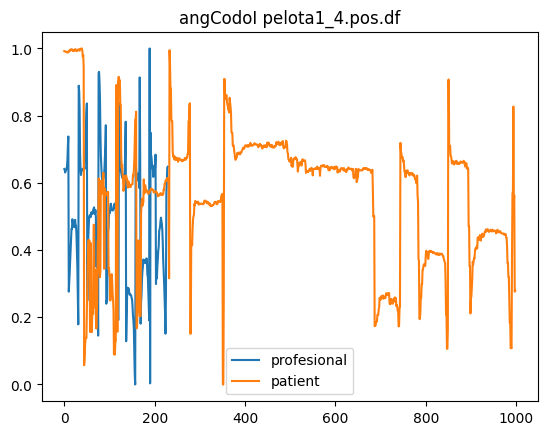

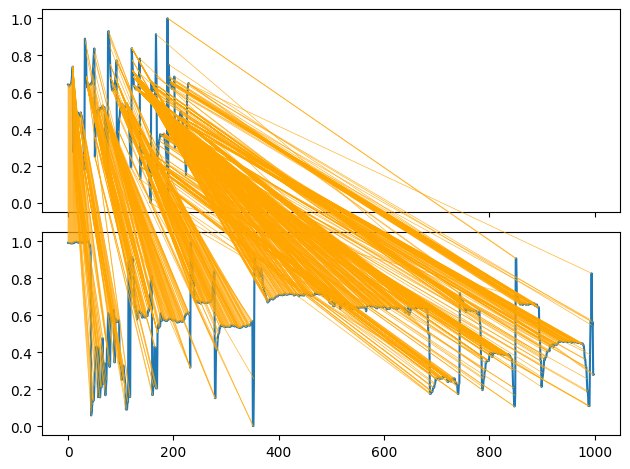

2.654562159285408


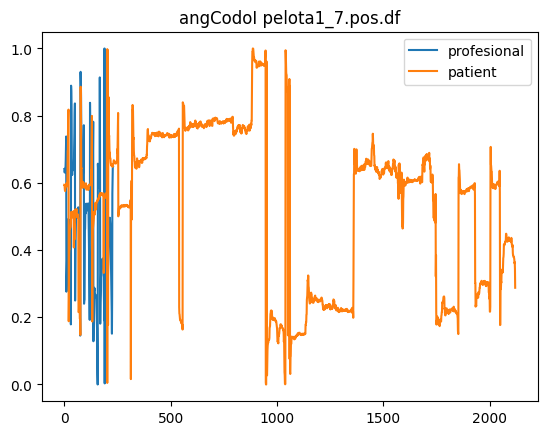

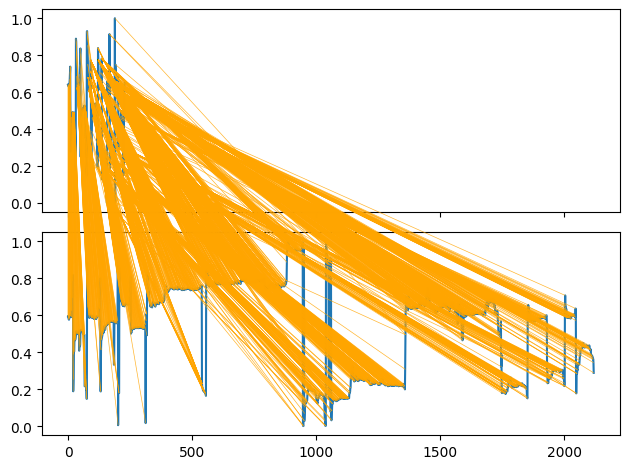

3.963013786184574


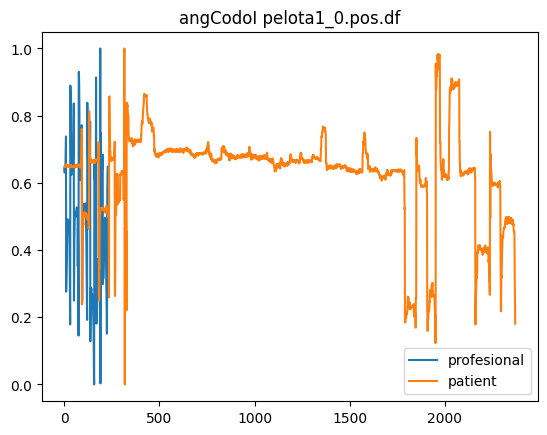

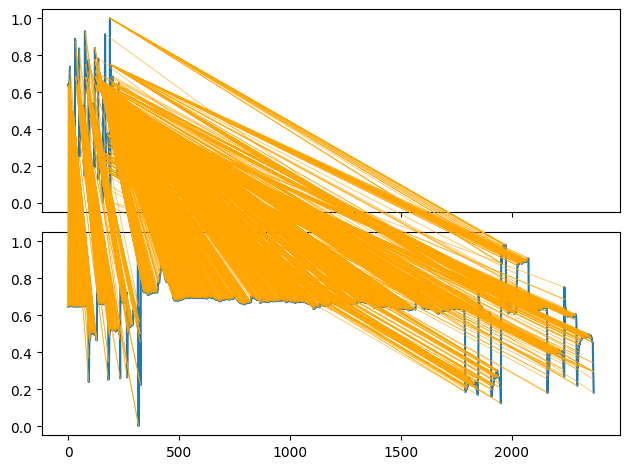

2.520736922632943


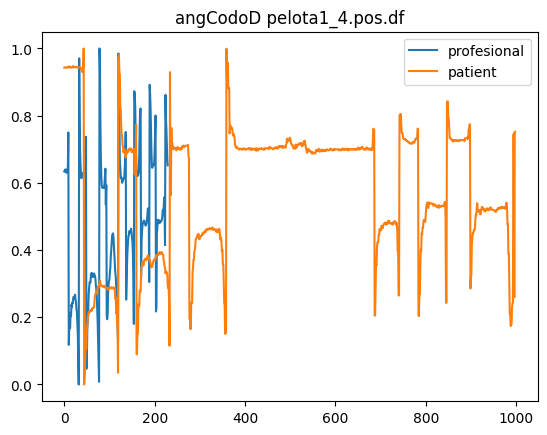

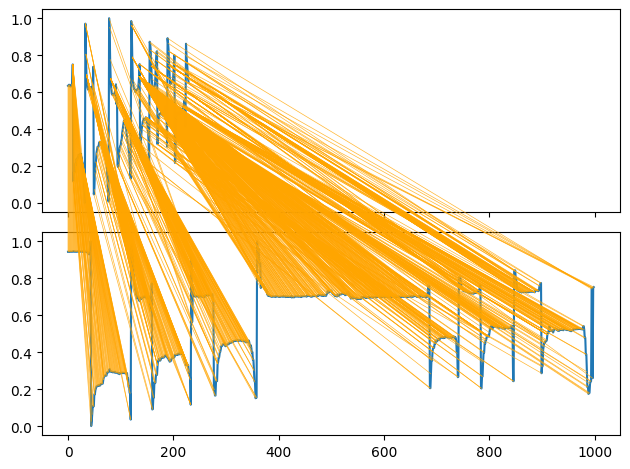

1.8971053646918175


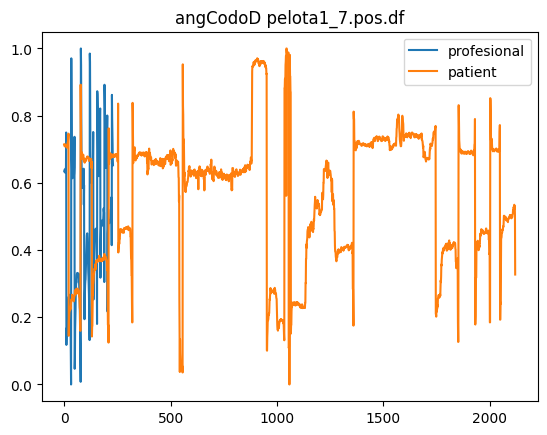

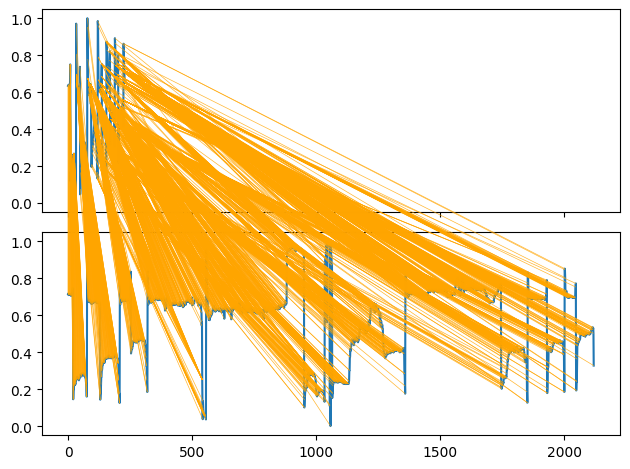

3.9115336099036684


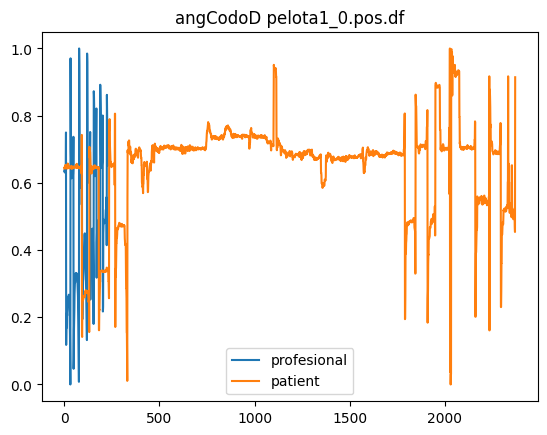

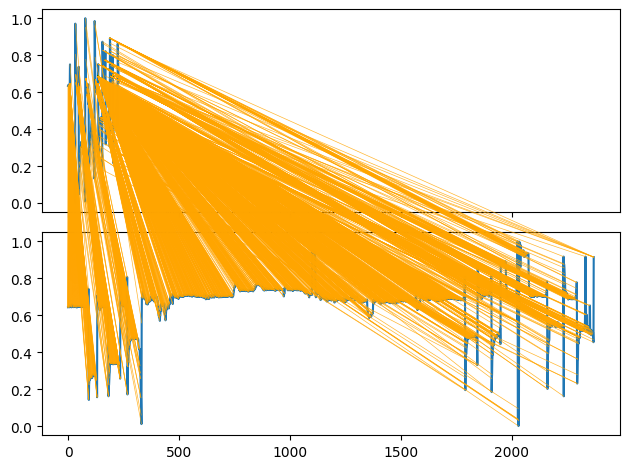

2.95778668682652


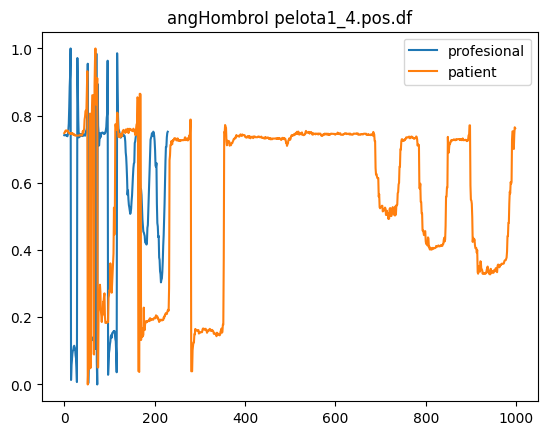

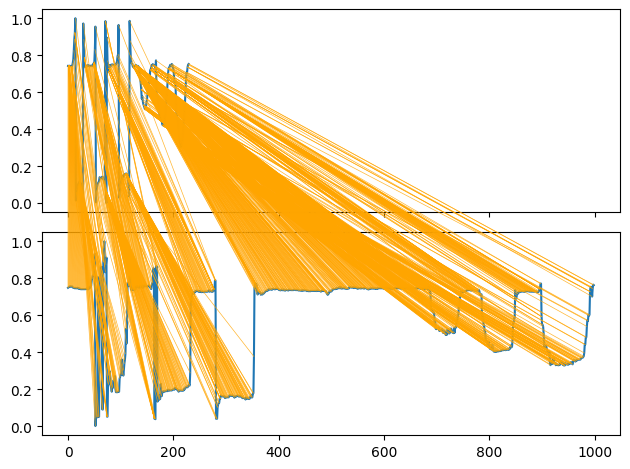

2.7203721116109856


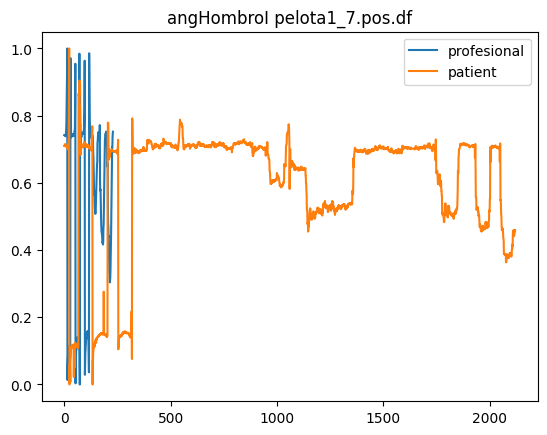

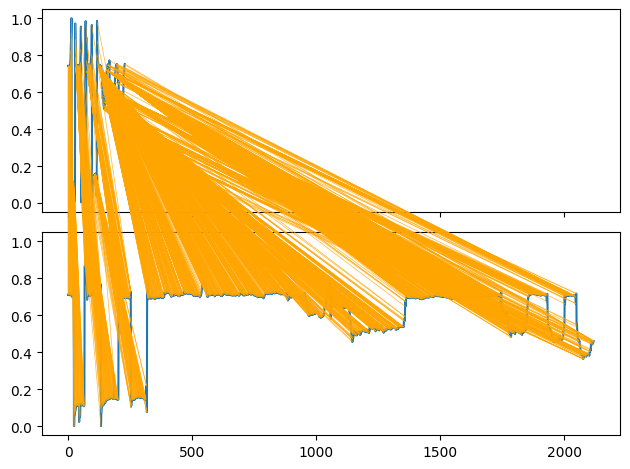

1.9354050341719289


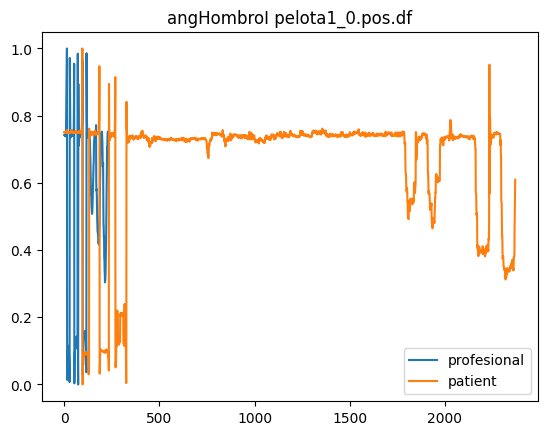

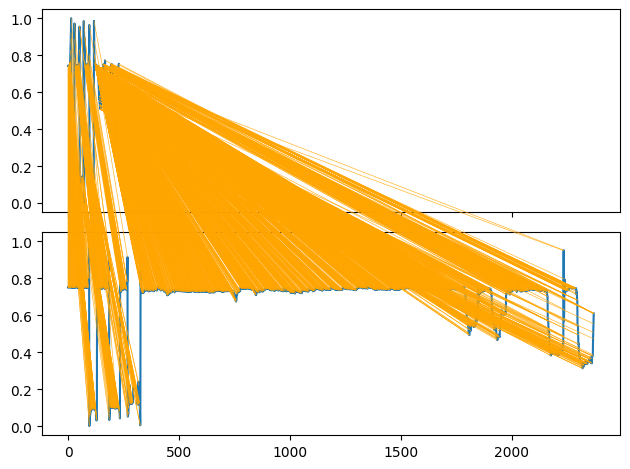

1.5540219988023747


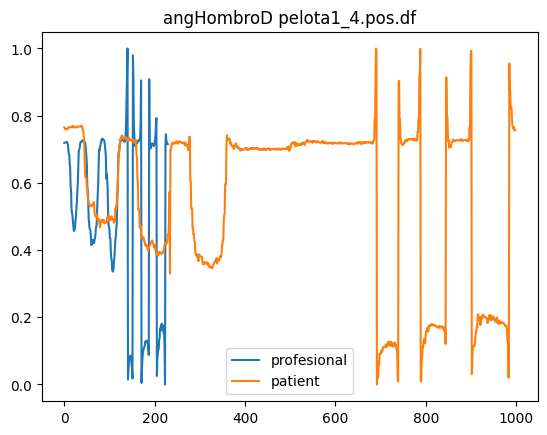

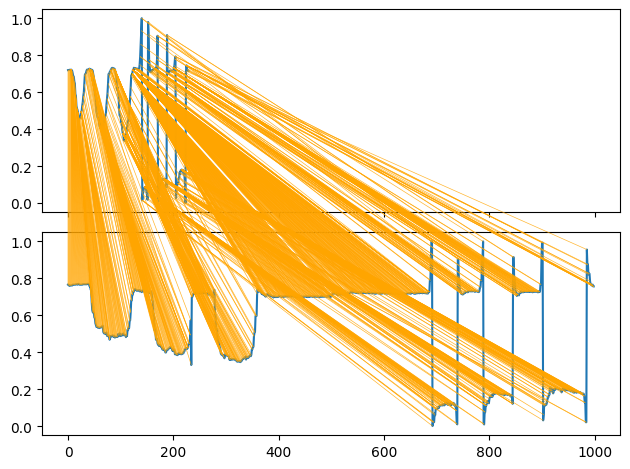

0.7744324522622936


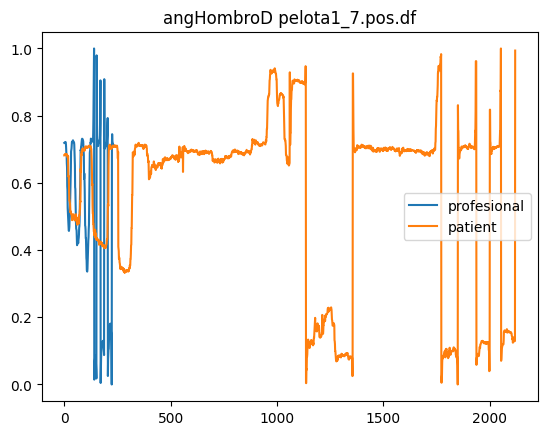

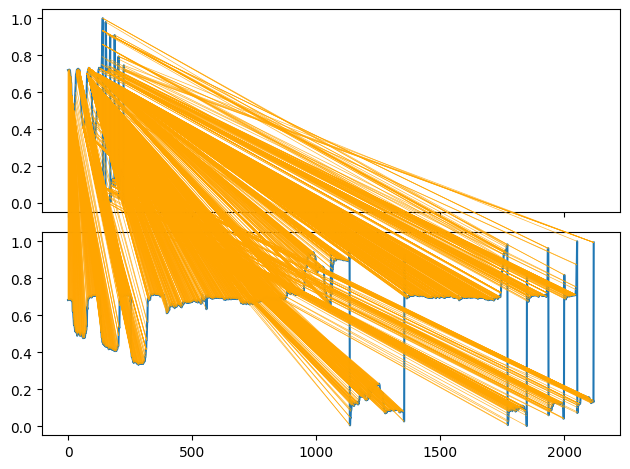

4.2355537618184345


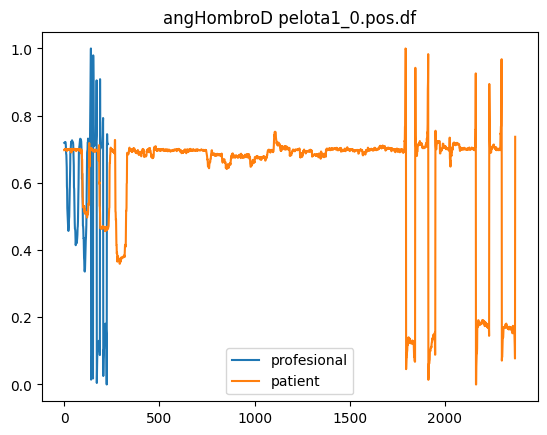

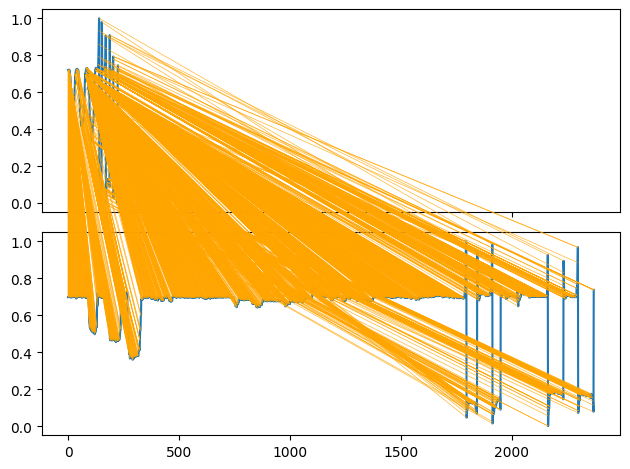

2.3854047451923615


In [30]:
for i in angles_pelota1:
    profesional_ej = None
    ej, profesional = next(iter(pelota1_profesionals.items()))
    profesional_ej = profesional[i]
    
    for ej, patient in pelota1_patients.items():
        plt.plot(profesional_ej, label="profesional")
        plt.plot(patient[i], label="patient")
        plt.title(i + " " + ej)
        plt.legend()
        plt.show()

        distance, paths = dtw.warping_paths_fast(np.asarray(profesional_ej), np.asarray(patient[i]))
        best_path = dtw.best_path(paths)
        dtwvis.plot_warping(profesional_ej, patient[i], best_path)
        plt.show()

        print(distance)

Pelota 2

In [31]:
angles_pelota2 = [
    'angCodoI', 
    'angCodoD', 
    'angHombroI', 
    'angHombroD'
    ]

In [32]:
dataframes_pelota2_patients = get_filenames_patients("pelota2")
dataframes_pelota2_patients = dataframes_pelota2_patients[:3]
pelota2_patients = {}
for ej2 in dataframes_pelota2_patients:
    temp = open_dataframe(ej2)
    temp = temp[angles_pelota2]
    pelota2_patients[ej2] = temp

dataframes_pelota2_profesionals = get_filenames_profesionals("pelota2")
pelota2_profesionals = {}
for ej2 in dataframes_pelota2_profesionals:
    temp = open_numpy(ej2)
    temp = temp[angles_pelota2]
    pelota2_profesionals[ej2] = temp

angCodoI


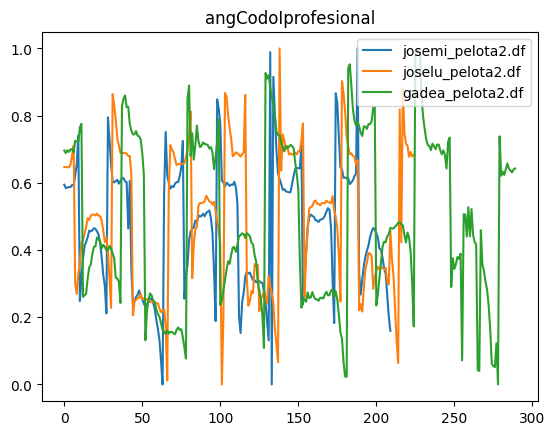

angCodoD


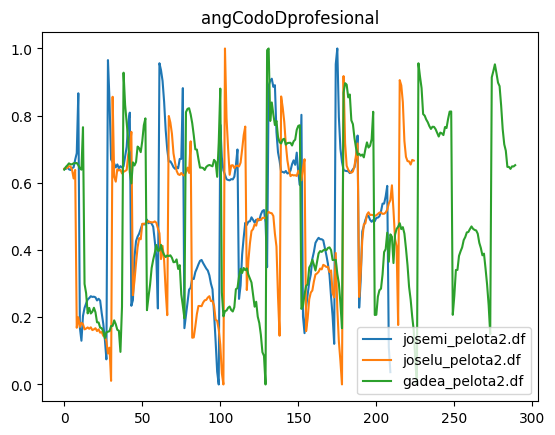

angHombroI


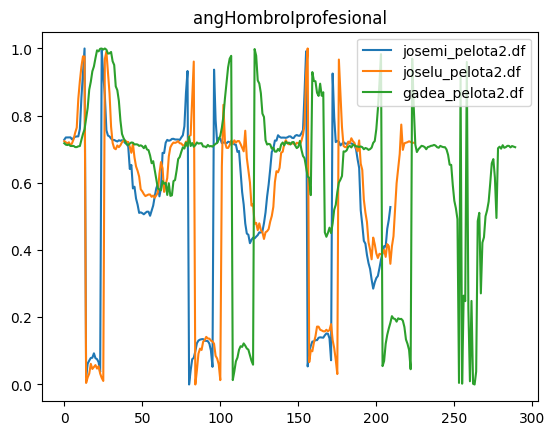

angHombroD


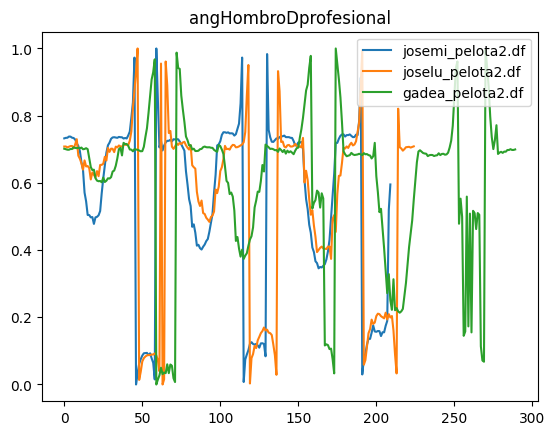

In [33]:
for i in angles_pelota2:
    #print(cruz_ej2_profesionals.items())
    print(i)
    profesional_ej = None
    for ej, profesional in pelota2_profesionals.items():
        profesional_ej = profesional[i]
    
        plt.plot(profesional_ej, label=ej)
    plt.title(i + "profesional")
    plt.legend()
    plt.show()

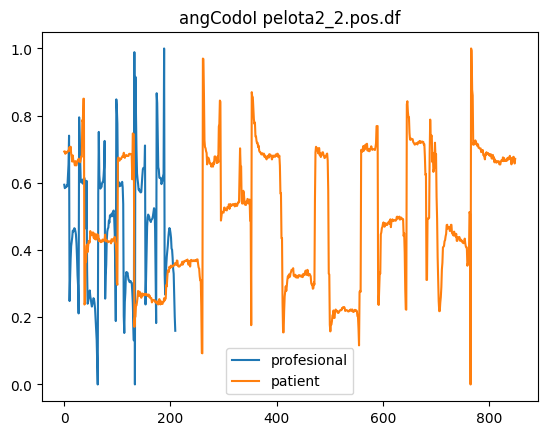

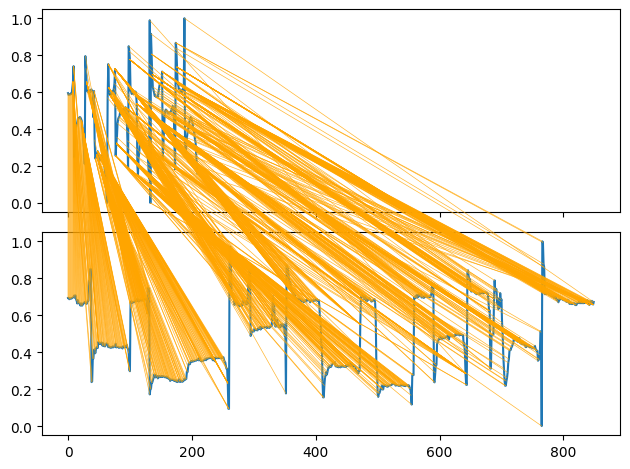

2.619225006966718


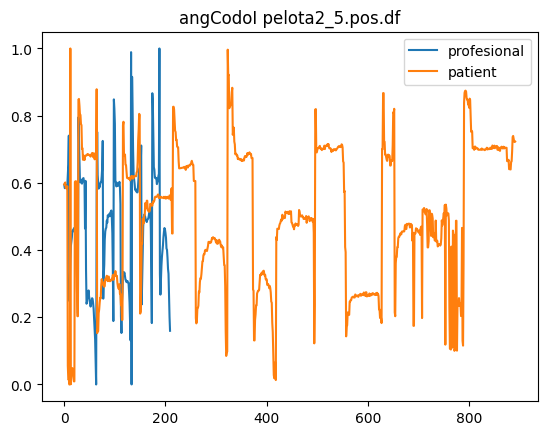

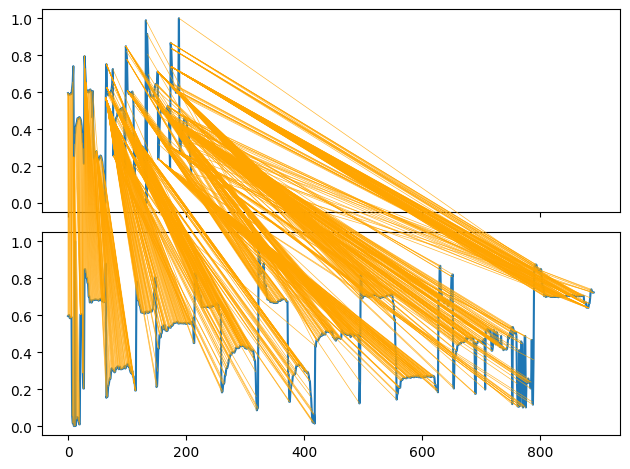

3.1801463647080292


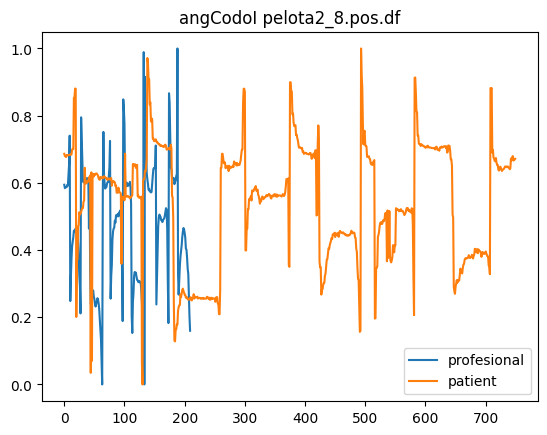

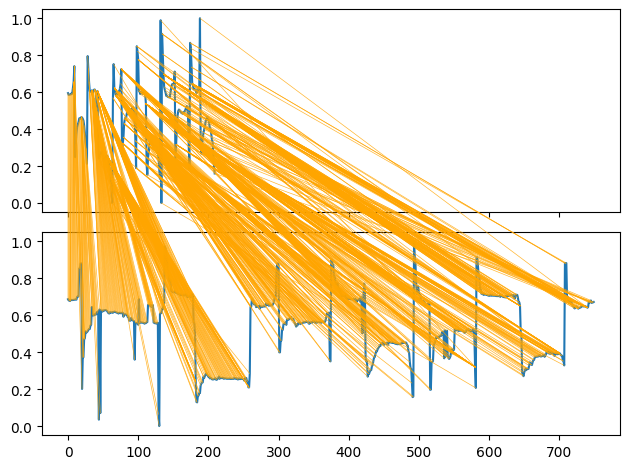

2.6740161374890383


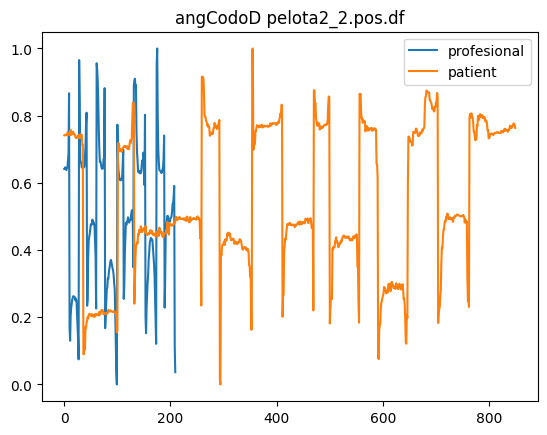

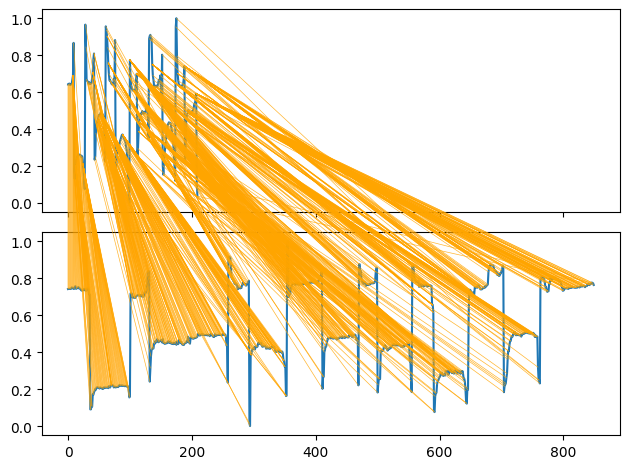

2.754273531374764


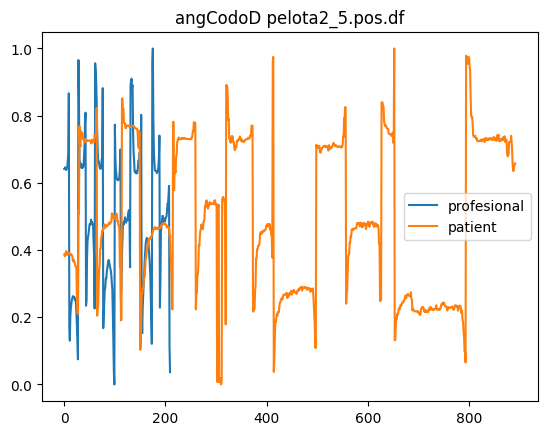

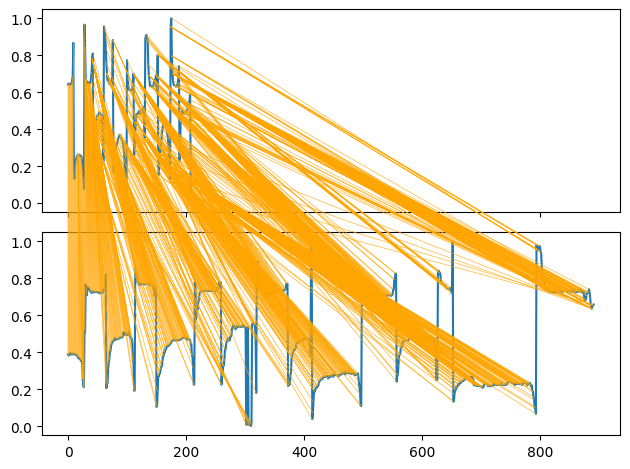

3.3928465271579578


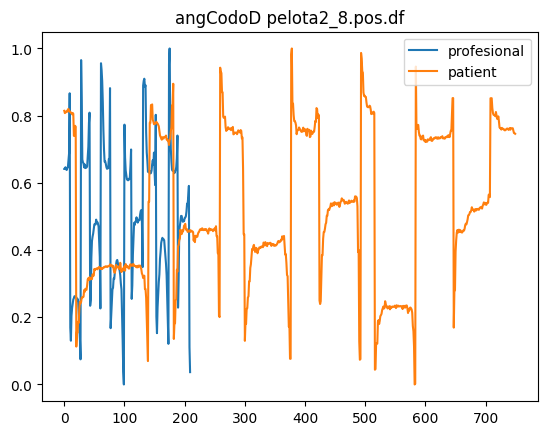

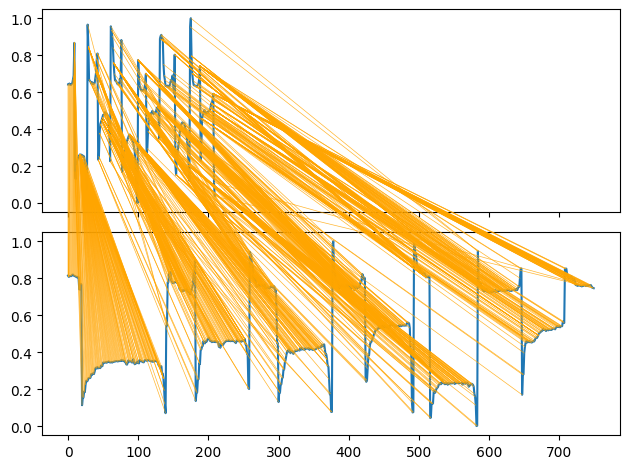

2.3784380999633066


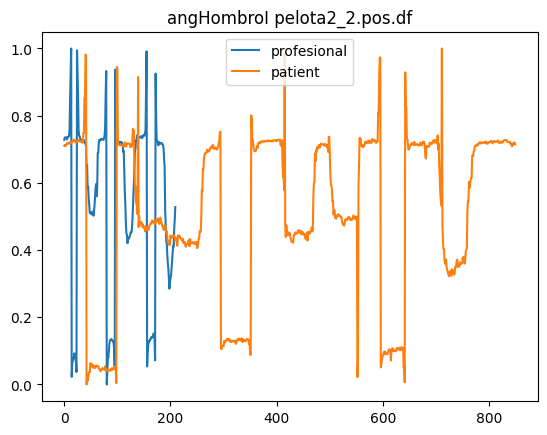

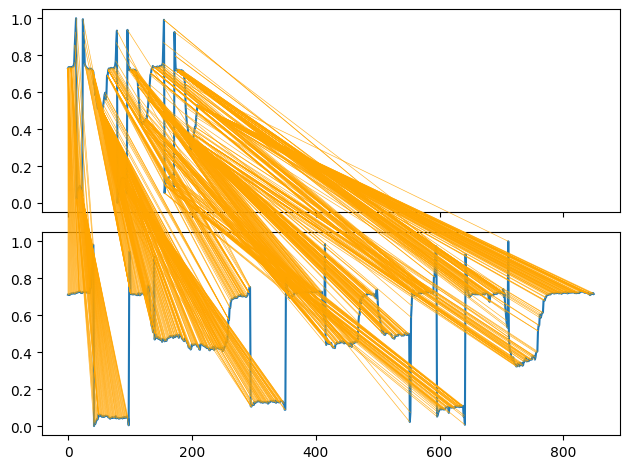

2.321238509615586


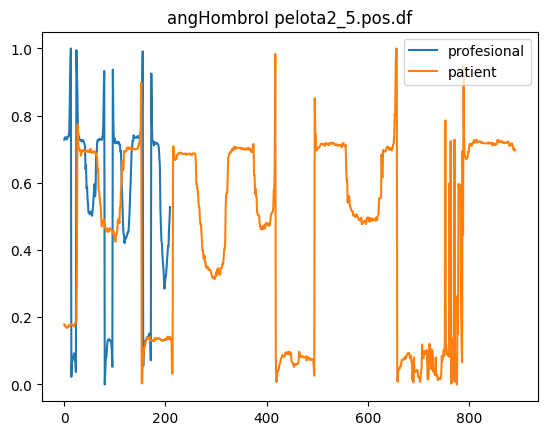

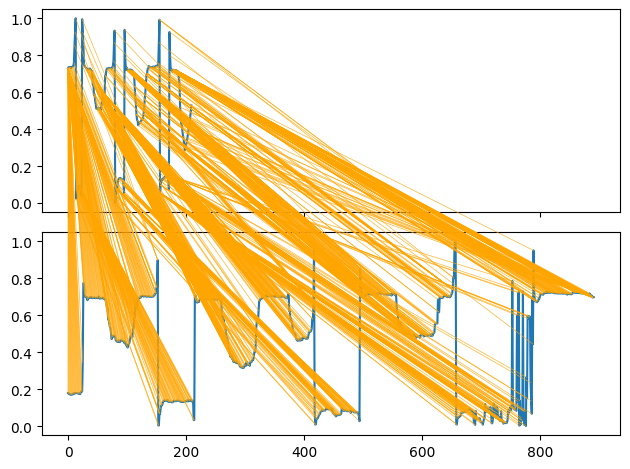

4.247706889567703


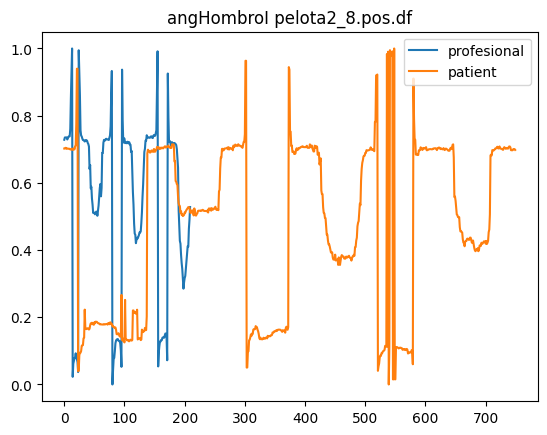

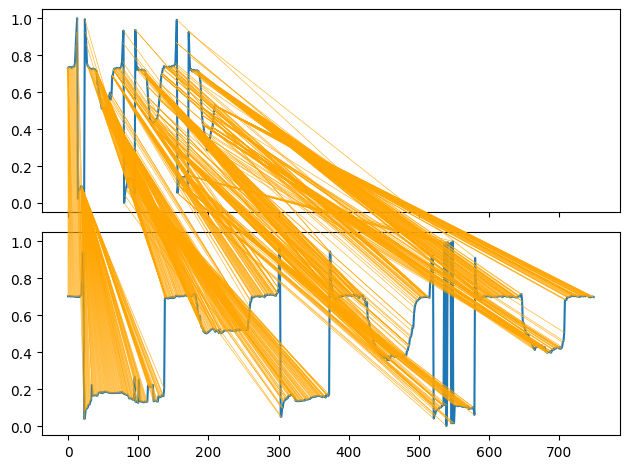

2.8569215296647625


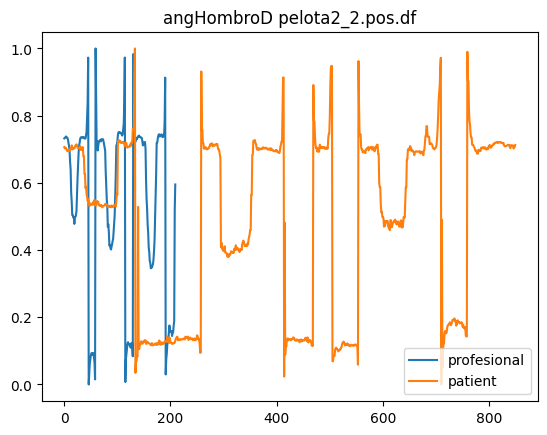

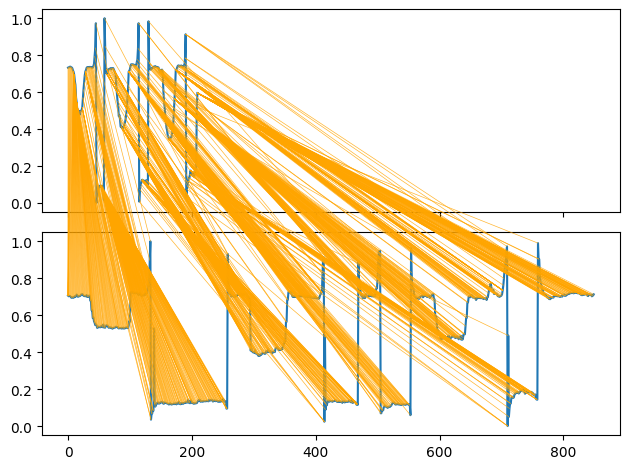

2.724440966031963


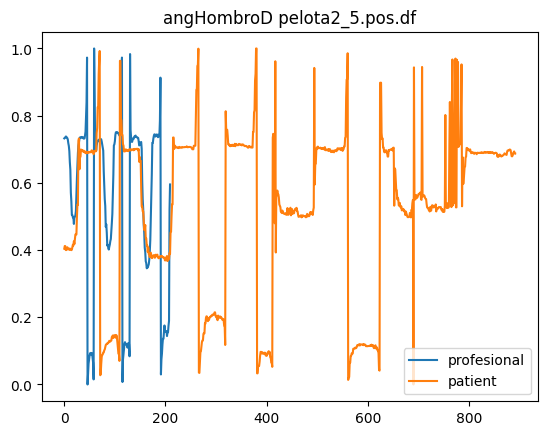

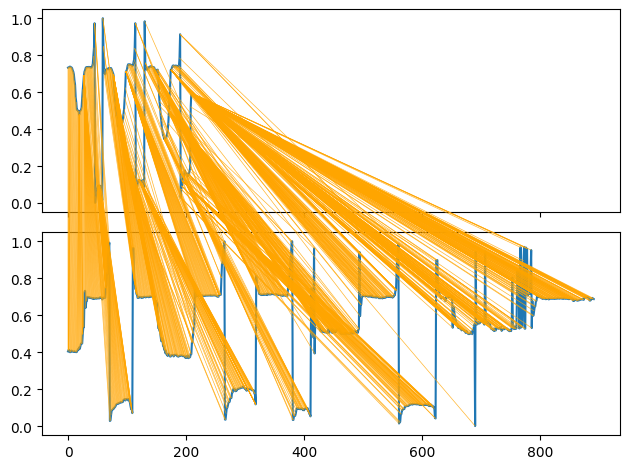

3.0419120324705644


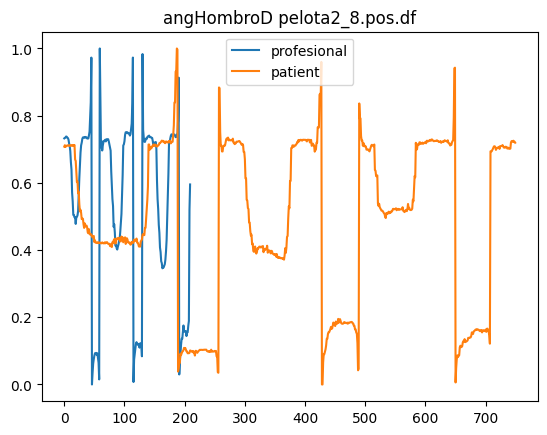

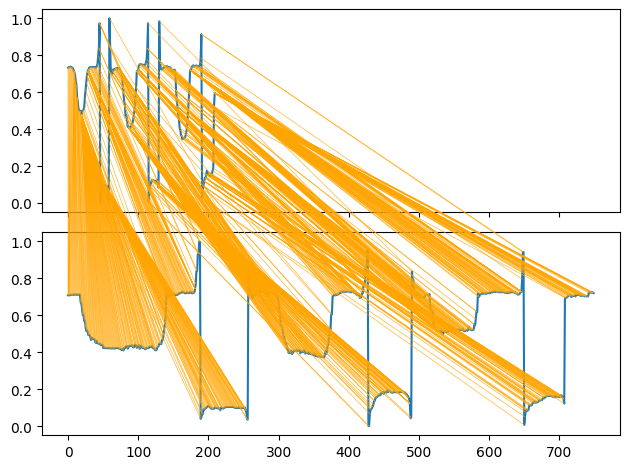

1.1254178403542587


In [34]:
for i in angles_pelota2:
    profesional_ej = None
    ej, profesional = next(iter(pelota2_profesionals.items()))
    profesional_ej = profesional[i]
    patient_ej = patient[i]
    
    for ej, patient in pelota2_patients.items():
        plt.plot(profesional_ej, label="profesional")
        plt.plot(patient[i], label="patient")
        plt.title(i + " " + ej)
        plt.legend()
        plt.show()

        distance, paths = dtw.warping_paths_fast(np.asarray(profesional_ej), np.asarray(patient[i]))
        best_path = dtw.best_path(paths)
        dtwvis.plot_warping(profesional_ej, patient[i], best_path)
        plt.show()

        print(distance)